# Project 10: Working with Geocoded Data

## Building Maps in _geopandas_

In this lesson we will download COVID-19 data from data.world. We will normalize the data to compare spread between counties. Were we to simply plot the total number of cases or deaths by county, the results would be biased as counties with larger populations would likely have more cases and more deaths. We will observe how the spread developed across the country, starting in the northeast, eventually making its way to other regions.

### Installing geopandas

Although there is a geopandas installation available using the *conda install* command in you command line shell, that package is incomplete for our purposes. We will need to install dependencies - in this order: *GDAL*,*Fiona*, and *Shapely* - for geopandas before installing geopandas. I have included the *.whl* files for each of these packages in the same folder is this notebook. Download the files and save them to your local folder. To install, use  the command:

> *pip install filename*

If you are using a machine for which you are not the administrator, use the command:

> *pip install filename --user*

Install the libraries using these commands from an administrator shell or using --user at the end of the statement: 

>*pip install GDAL-3.1.4-cp37-cp37m-win_amd64.whl*

>*pip install Fiona-1.8.17-cp37-cp37m-win_amd64.whl*

>*pip install Shapely-1.7.1-cp37-cp37m-win_amd64.whl*

If you are using Python 3.8, use the following wheels:

>*pip install GDAL-3.1.4-cp38-cp38-win_amd64.whl*

>*pip install Fiona-1.8.17-cp38-cp38-win_amd64.whl*

>*pip install Shapely-1.7.1-cp38-cp38-win_amd64.whl*

If you are using a mac, you may install the appropriate module by selecting the version.

> *pip install -v GDAL==3.1.4*

> *pip install -v Fiona==1.8.17*

> *pip install -v Shapely==1.7.1*

Finally, install geopandas:

> *pip install geopandas*

In [2]:
# !pip install GDAL-3.1.4-cp39-cp39m-win_amd64.whl
# !pip install Fiona-1.8.17-cp39-cp39m-win_amd64.whl
# !pip install Shapely-1.7.1-cp39-cp39m-win_amd64.whl 
# !pip install geopandas
# !pip install datadotworld

In [3]:
#COVID19Map.py
### import all modules that we will use in this lesson
import geopandas
import numpy as np
import pandas as pd
# We won't actually use datetime directly. Since the dataframe index will use 
# data formatted as datetime64, I import it in case I need to use the datetime
# module to troubleshoot later 
import datetime
# you could technically call many of the submodules from matplotlib using mpl., 
#but for convenience we explicitly import submodules. These will be used for 
# constructing visualizations
import matplotlib as mpl
import matplotlib.pyplot as plt
c# If you choose to make a dynamic visualization for the homework
from matplotlib.animation import FuncAnimation
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.ticker as mtick

def import_geo_data(filename, index_col = "Date", FIPS_name = "FIPS"):
    # import county level shapefile
    map_data = geopandas.read_file(filename = filename,                                   
                                   index_col = index_col)
    # rename fips code to match variable name in COVID-19 data
    map_data.rename(columns={"State":"state"},
                    inplace = True)
    # Combine statefips and county fips to create a single fips value
    # that identifies each particular county without referencing the 
    # state separately
    map_data[FIPS_name] = map_data["STATEFP"].astype(str) + \
        map_data["COUNTYFP"].astype(str)
    map_data[FIPS_name] = map_data[FIPS_name].astype(np.int64)
    # set FIPS as index
    map_data.set_index(FIPS_name, inplace=True)
    
    return map_data

plt.rcParams['axes.ymargin'] = 0
plt.rcParams['axes.xmargin'] = 0
plt.rcParams.update({'font.size': 32})

#if "data_processed" not in locals():
fips_name = "fips_code"
# covid_filename = "COVID19DataAP.csv"
# rename_FIPS matches map_data FIPS with COVID19 FIPS name
map_data = import_geo_data(
    filename = "countiesWithStatesAndPopulation.shp",
    index_col = "Date", FIPS_name= fips_name)
# dates will be used to create a geopandas DataFrame with multiindex 


Now we have separately imported the geodata and downloaded the COVID-19 data. Let's check both dataframes.

First, let's use the *.plot()* method to preview how geopandas works.

<AxesSubplot:>

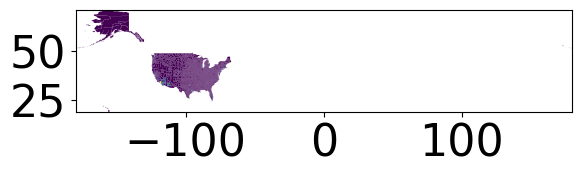

In [4]:
map_data.plot(column = "Population")

The size of the figure and the area covered is too extensive. Before plotting, we will increase the size of the figure and reduce the area plotted (we will exclude Alaska and Hawaii for this purpose). 

Next, let's check the geodataframe.

In [5]:
map_data

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,NAME,LSAD,ALAND,AWATER,Population,state,geometry
fips_code,,,,,,,,,,,
21007,21,007,00516850,0500000US21007,Ballard,06,639387454,69473325,7888.0,Kentucky,"POLYGON ((-89.18137 37.04630, -89.17938 37.053..."
21017,21,017,00516855,0500000US21017,Bourbon,06,750439351,4829777,19788.0,Kentucky,"POLYGON ((-84.44266 38.28324, -84.44114 38.283..."
21031,21,031,00516862,0500000US21031,Butler,06,1103571974,13943044,12879.0,Kentucky,"POLYGON ((-86.94486 37.07341, -86.94346 37.074..."
21065,21,065,00516879,0500000US21065,Estill,06,655509930,6516335,14106.0,Kentucky,"POLYGON ((-84.12662 37.64540, -84.12483 37.646..."
21069,21,069,00516881,0500000US21069,Fleming,06,902727151,7182793,14581.0,Kentucky,"POLYGON ((-83.98428 38.44549, -83.98246 38.450..."
...,...,...,...,...,...,...,...,...,...,...,...
31073,31,073,00835858,0500000US31073,Gosper,06,1186616237,11831826,1990.0,Nebraska,"POLYGON ((-100.09510 40.43866, -100.08937 40.4..."
39075,39,075,01074050,0500000US39075,Holmes,06,1094405866,3695230,43960.0,Ohio,"POLYGON ((-82.22066 40.66758, -82.19327 40.667..."
48171,48,171,01383871,0500000US48171,Gillespie,06,2740719114,9012764,26988.0,Texas,"POLYGON ((-99.30400 30.49983, -99.28234 30.499..."


We can see that counties are identified by a state, with reference to the states fip code, and by a county level fip code. Together, these make the total fip code. We will use the fip code to align the data frames.

Notice also that each observation is associated with an entry under **geometry**. Each entry has identified with it the shape and location of the county identified by a series of coordinates representing the perimeter of the county.

Next, let's call the COVID-19 data.

We are almost ready to create our first map! Much of the same structure for plotting other visualizations in *matplotlib* using *pandas* also applies to using *geopandas* to create maps. We will initiate a figure using *plt.subplots()*. Since we are plotting time series data, we will need to plot only one date at a time. Let's start with the most recent data available.

To start, we need to select data from counties  within the 48 states, otherwise Alaska and Hawaii will be include. This allows the area represented to be much smaller. The measures that are slected are rough estimates, but all that matters is that the 48 states reside within the boundaries chosen. Similar to the *data_processed* variable, I include a *map_bounded* variable so that this computation will not be repeated when the script is run multiple times.

In [6]:
import pandas as pd
#import unemployment data
u_data = pd.read_csv(
    "countyUnemploymentData.csv", 
    encoding = "latin1", 
    parse_dates = True, 
    index_col="date")
# drop observations with missing fips codes
u_data.reset_index(inplace = True)
index = u_data["fips_code"].dropna(axis = 0).index
u_data = u_data.loc[index]

u_data["fips_code"] = u_data["fips_code"].astype(int)
u_data.set_index(["fips_code", "date"], inplace = True)
u_data = u_data[list(u_data.keys())[-4:]]

C:\Users\JLCat\AppData\Local\Temp\ipykernel_14928\3822417782.py:3: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  u_data = pd.read_csv(


In [7]:
u_data

,,Labor Force,Employed,Unemployed,Unemployment Rate
fips_code,date,,,,
1001,2019-08-01,"26,079","25,368",711,2.7
1003,2019-08-01,"97,939","95,367","2,572",2.6
1005,2019-08-01,"8,652","8,322",330,3.8
1007,2019-08-01,"8,670","8,403",267,3.1
1009,2019-08-01,"25,309","24,641",668,2.6
...,...,...,...,...,...
72145,2021-06-01,"12,993","11,580","1,413",10.9
72147,2021-06-01,"2,610","2,288",322,12.3
72149,2021-06-01,"6,940","6,152",788,11.4


Unlike the previous set of data, the unemployment data is monthly, not daily.

In [8]:
map_data = map_data.reset_index().set_index("fips_code")
# map_data.drop("date", axis = 1, inplace = True)
map_data

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,NAME,LSAD,ALAND,AWATER,Population,state,geometry
fips_code,,,,,,,,,,,
21007,21,007,00516850,0500000US21007,Ballard,06,639387454,69473325,7888.0,Kentucky,"POLYGON ((-89.18137 37.04630, -89.17938 37.053..."
21017,21,017,00516855,0500000US21017,Bourbon,06,750439351,4829777,19788.0,Kentucky,"POLYGON ((-84.44266 38.28324, -84.44114 38.283..."
21031,21,031,00516862,0500000US21031,Butler,06,1103571974,13943044,12879.0,Kentucky,"POLYGON ((-86.94486 37.07341, -86.94346 37.074..."
21065,21,065,00516879,0500000US21065,Estill,06,655509930,6516335,14106.0,Kentucky,"POLYGON ((-84.12662 37.64540, -84.12483 37.646..."
21069,21,069,00516881,0500000US21069,Fleming,06,902727151,7182793,14581.0,Kentucky,"POLYGON ((-83.98428 38.44549, -83.98246 38.450..."
...,...,...,...,...,...,...,...,...,...,...,...
31073,31,073,00835858,0500000US31073,Gosper,06,1186616237,11831826,1990.0,Nebraska,"POLYGON ((-100.09510 40.43866, -100.08937 40.4..."
39075,39,075,01074050,0500000US39075,Holmes,06,1094405866,3695230,43960.0,Ohio,"POLYGON ((-82.22066 40.66758, -82.19327 40.667..."
48171,48,171,01383871,0500000US48171,Gillespie,06,2740719114,9012764,26988.0,Texas,"POLYGON ((-99.30400 30.49983, -99.28234 30.499..."


In [9]:
#COVID19Map.py
# . . .
import copy as copy
def create_merged_geo_dataframe(data, map_data, dates):
    data_frame_initialized = False
    # use groupby to generate a df with only the fips_code index
    # then save that index as the variable counties
    matching_gpd = {}
    counties =data.index.get_level_values("fips_code").unique()
    for key, val in data.items():
        matching_gpd[key] = copy.copy(map_data[map_data.index.isin(counties)])
        for date in dates:
            val_slice = val[val.index.get_level_values("date") == date]
            val_slice = val_slice.reset_index(drop = False).set_index("fips_code")
            matching_gpd[key][date] = val_slice[key]

    return matching_gpd

# dates will be used to create a geopandas DataFrame with multiindex 
# dates = sorted(list(set(u_data.index.get_level_values("date"))))
dates = u_data.index.get_level_values("date").unique()
u_data = create_merged_geo_dataframe(u_data, map_data, dates)
u_data

C:\Users\JLCat\AppData\Local\Temp\ipykernel_14928\1829345748.py:21: FutureWarning: Dropping invalid columns in DataFrameGroupBy.mean is deprecated. In a future version, a TypeError will be raised. Before calling .mean, select only columns which should be valid for the function.
  dates = u_data.groupby("date").mean().index
C:\Users\JLCat\AppData\Local\Temp\ipykernel_14928\1829345748.py:9: FutureWarning: Dropping invalid columns in DataFrameGroupBy.mean is deprecated. In a future version, a TypeError will be raised. Before calling .mean, select only columns which should be valid for the function.
  counties =data.groupby("fips_code").mean().index


{'Labor Force':            STATEFP COUNTYFP  COUNTYNS        AFFGEOID       NAME LSAD  \
 fips_code                                                               
 21007           21      007  00516850  0500000US21007    Ballard   06   
 21017           21      017  00516855  0500000US21017    Bourbon   06   
 21031           21      031  00516862  0500000US21031     Butler   06   
 21065           21      065  00516879  0500000US21065     Estill   06   
 21069           21      069  00516881  0500000US21069    Fleming   06   
 ...            ...      ...       ...             ...        ...  ...   
 31073           31      073  00835858  0500000US31073     Gosper   06   
 39075           39      075  01074050  0500000US39075     Holmes   06   
 48171           48      171  01383871  0500000US48171  Gillespie   06   
 55079           55      079  01581100  0500000US55079  Milwaukee   06   
 26139           26      139  01623012  0500000US26139     Ottawa   06   
 
                 ALAN

In [10]:
# change values to numeric values
for key in u_data.keys():
    if u_data[key][dates[0]].dtypes == object:
        for date in dates:
            u_data[key][date] = pd.to_numeric(u_data[key][date], errors = "coerce")

In [11]:
#COVID19Map.py
#. . . 

# only include observations within these boundaries
# this will shrink the size of the map
def select_data_within_bounds(data, minx, miny, maxx, maxy):
    data = data[data.bounds["maxx"] <= maxx]
    data = data[data.bounds["maxy"] <= maxy]
    data = data[data.bounds["minx"] >= minx]
    data = data[data.bounds["miny"] >= miny]
    
    return data

date = dates[-1]
for key, val in u_data.items():
    df = u_data[key]    
    minx = df.bounds["minx"].min()
    miny = df.bounds["miny"].min()
    maxx = -58
    maxy = df.bounds["maxy"].max()
    # find counties using only 1 date, only performs operation once instead of 
    # several hundred times
    bounded_data =  select_data_within_bounds(df, minx, miny, maxx, maxy)
    u_data[key] = bounded_data
#     counties = bounded_data.groupby("fips_code").mean().index
#     covid_map_data =covid_data[covid_data.index.get_level_values("fips_code").isin(counties)]
u_data

{'Labor Force':            STATEFP COUNTYFP  COUNTYNS        AFFGEOID       NAME LSAD  \
 fips_code                                                               
 21007           21      007  00516850  0500000US21007    Ballard   06   
 21017           21      017  00516855  0500000US21017    Bourbon   06   
 21031           21      031  00516862  0500000US21031     Butler   06   
 21065           21      065  00516879  0500000US21065     Estill   06   
 21069           21      069  00516881  0500000US21069    Fleming   06   
 ...            ...      ...       ...             ...        ...  ...   
 31073           31      073  00835858  0500000US31073     Gosper   06   
 39075           39      075  01074050  0500000US39075     Holmes   06   
 48171           48      171  01383871  0500000US48171  Gillespie   06   
 55079           55      079  01581100  0500000US55079  Milwaukee   06   
 26139           26      139  01623012  0500000US26139     Ottawa   06   
 
                 ALAN

C:\Users\JLCat\AppData\Local\Temp\ipykernel_14928\2817614358.py:28: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(vals)#[int(x) for x in vals])


<class 'geopandas.geodataframe.GeoDataFrame'>


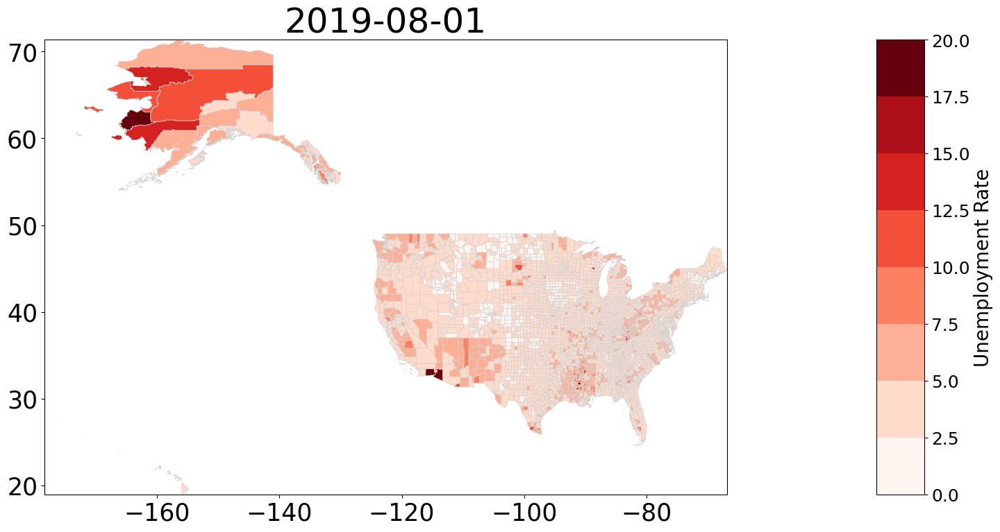

<class 'geopandas.geodataframe.GeoDataFrame'>


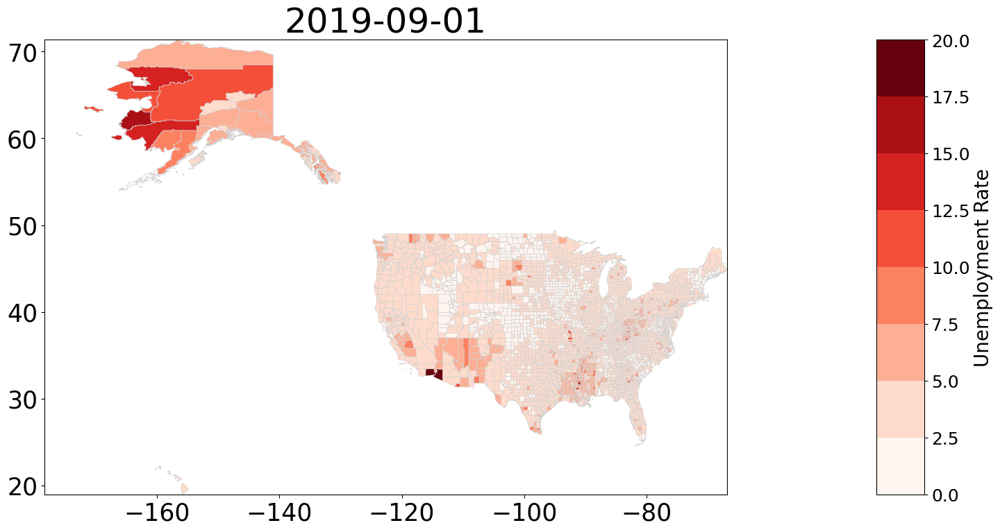

<class 'geopandas.geodataframe.GeoDataFrame'>


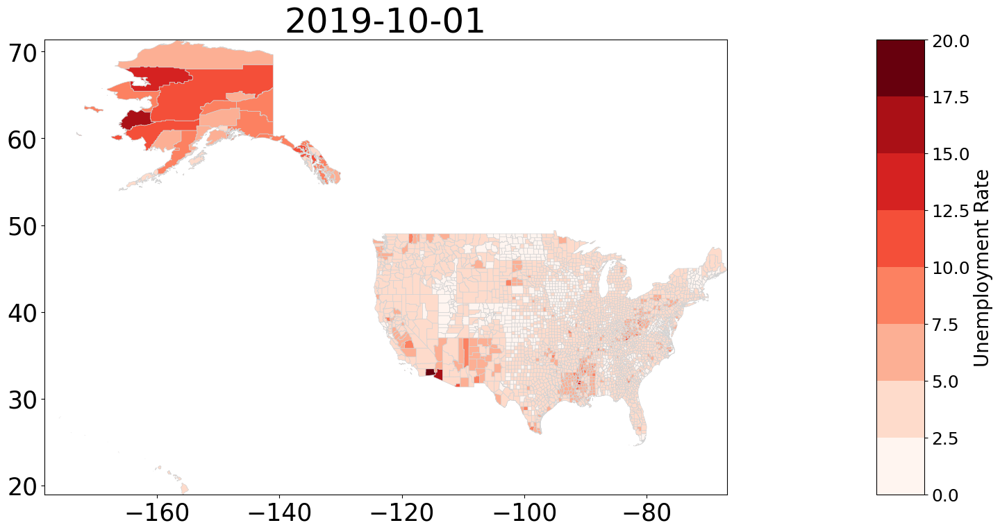

<class 'geopandas.geodataframe.GeoDataFrame'>


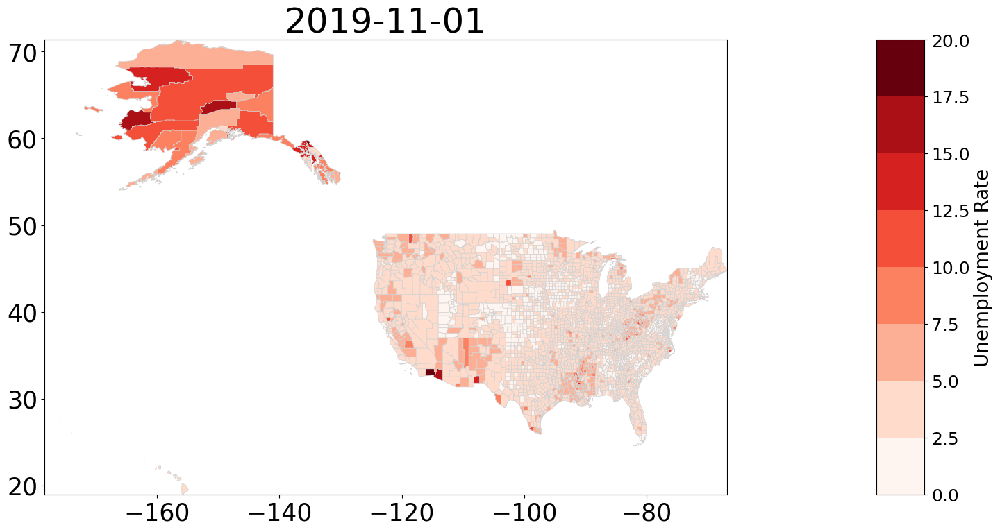

<class 'geopandas.geodataframe.GeoDataFrame'>


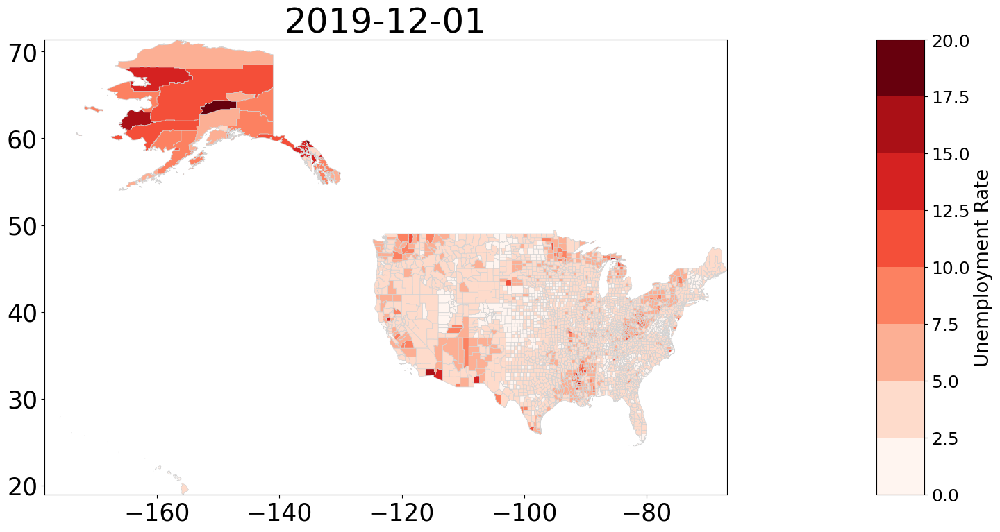

<class 'geopandas.geodataframe.GeoDataFrame'>


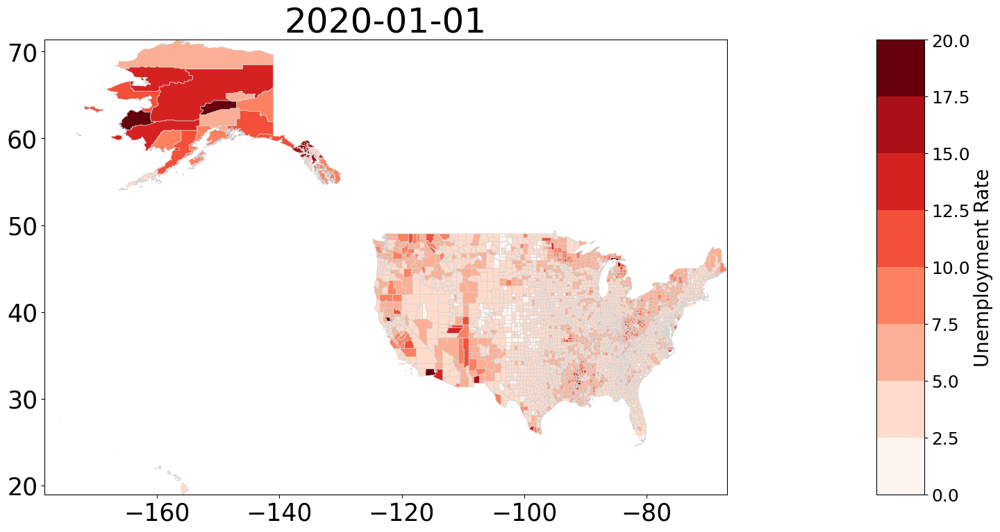

<class 'geopandas.geodataframe.GeoDataFrame'>


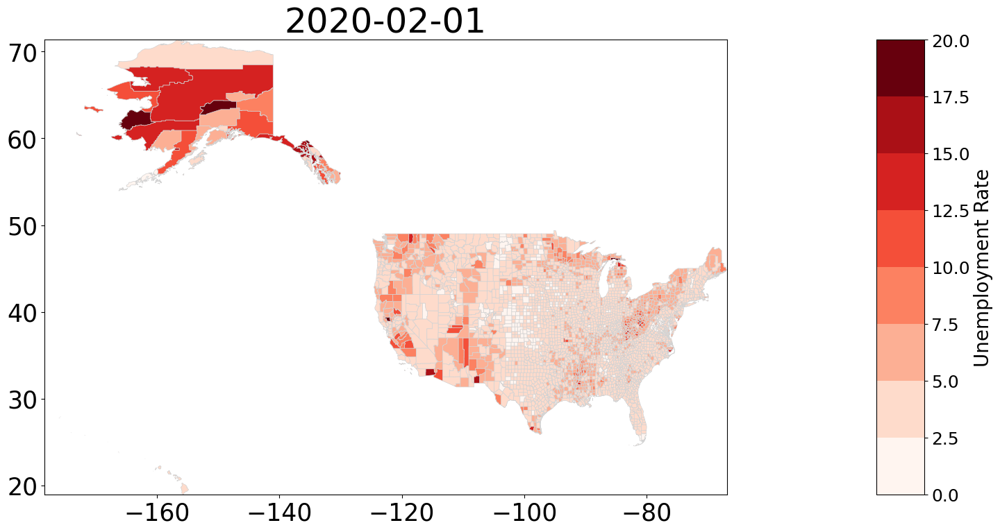

<class 'geopandas.geodataframe.GeoDataFrame'>


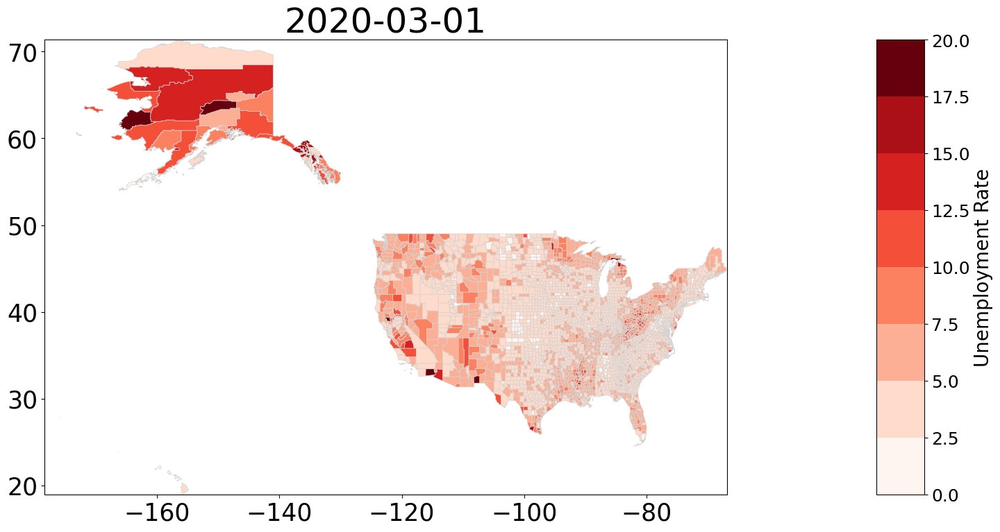

<class 'geopandas.geodataframe.GeoDataFrame'>


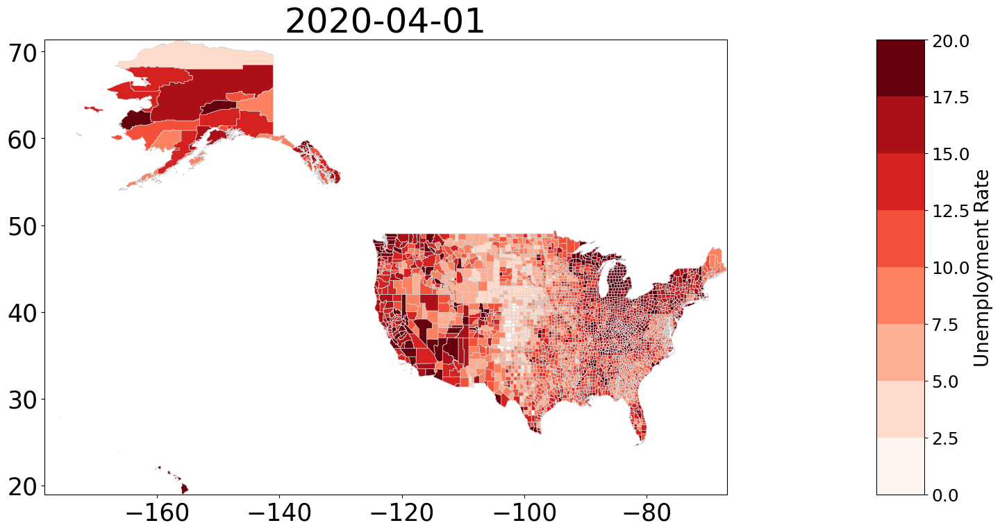

<class 'geopandas.geodataframe.GeoDataFrame'>


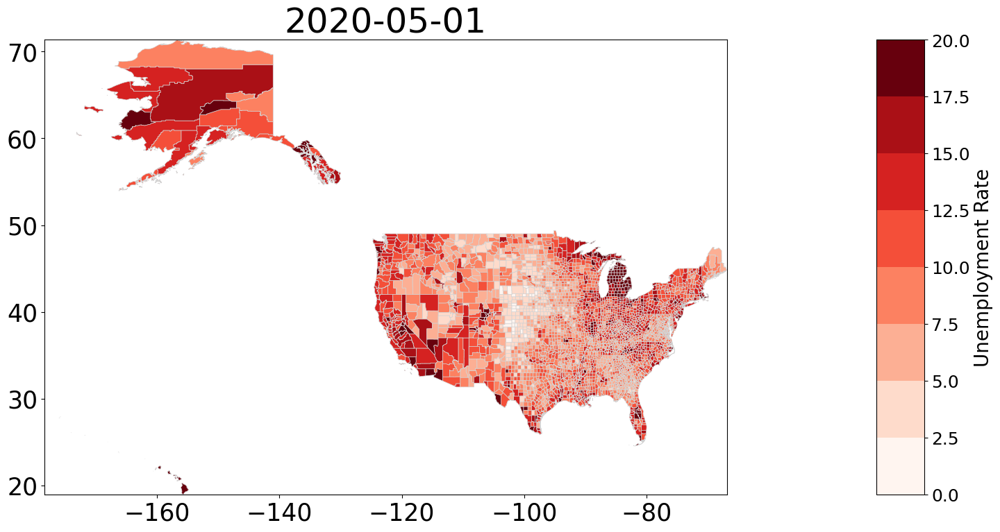

<class 'geopandas.geodataframe.GeoDataFrame'>


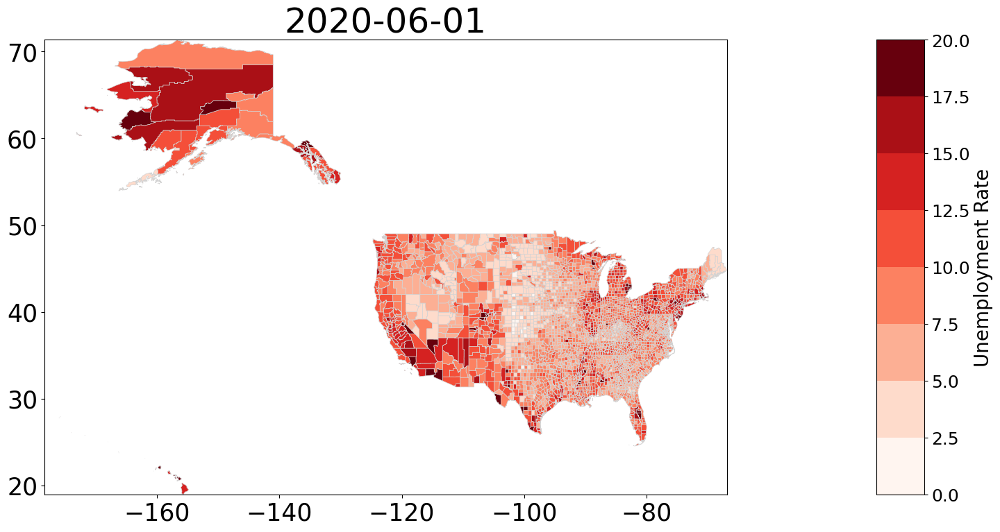

<class 'geopandas.geodataframe.GeoDataFrame'>


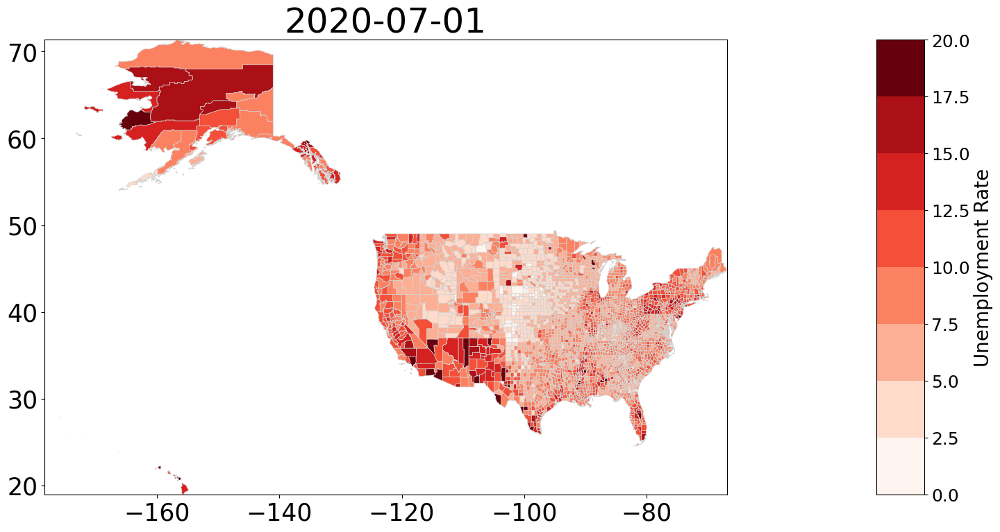

<class 'geopandas.geodataframe.GeoDataFrame'>


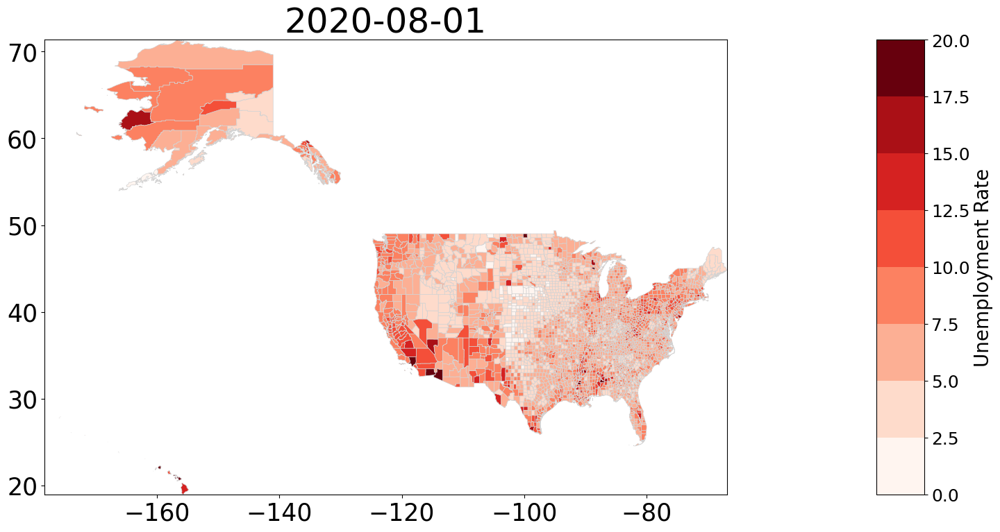

<class 'geopandas.geodataframe.GeoDataFrame'>


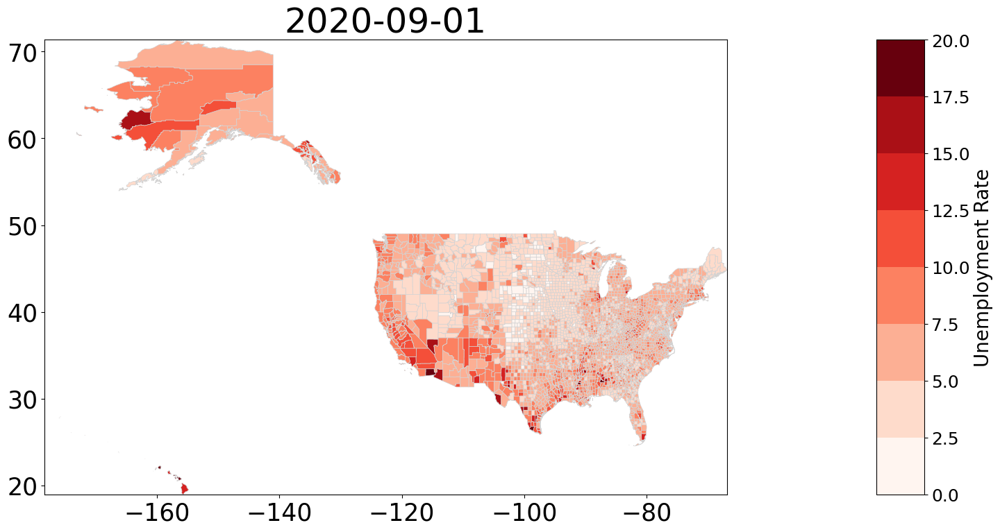

<class 'geopandas.geodataframe.GeoDataFrame'>


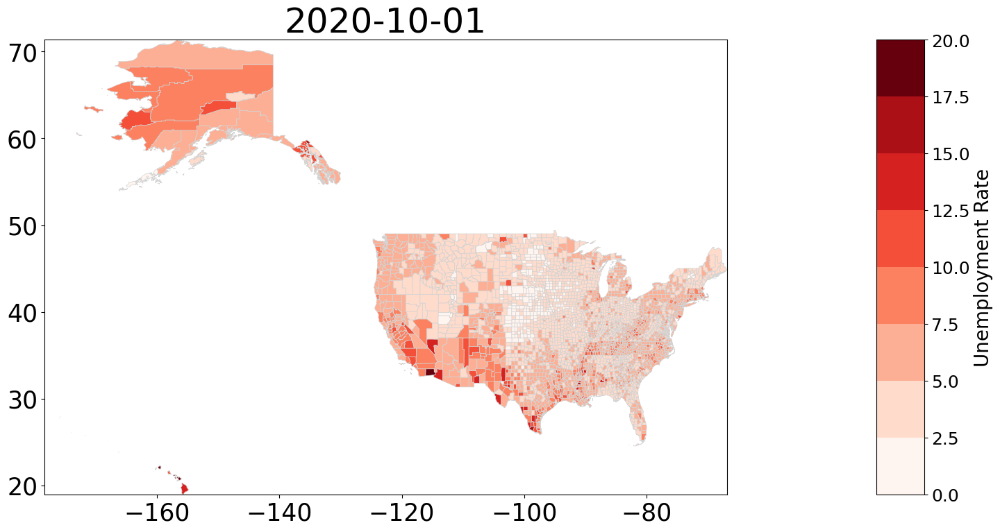

<class 'geopandas.geodataframe.GeoDataFrame'>


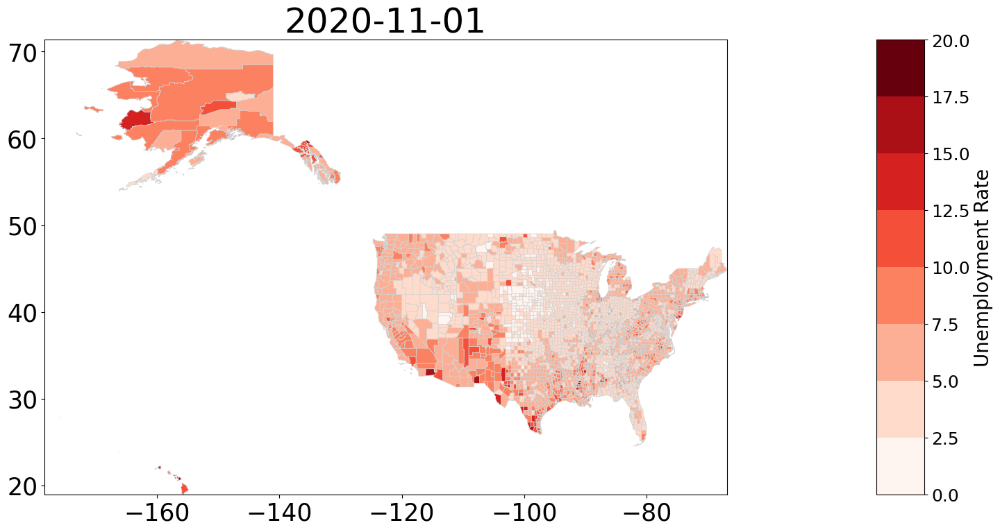

<class 'geopandas.geodataframe.GeoDataFrame'>


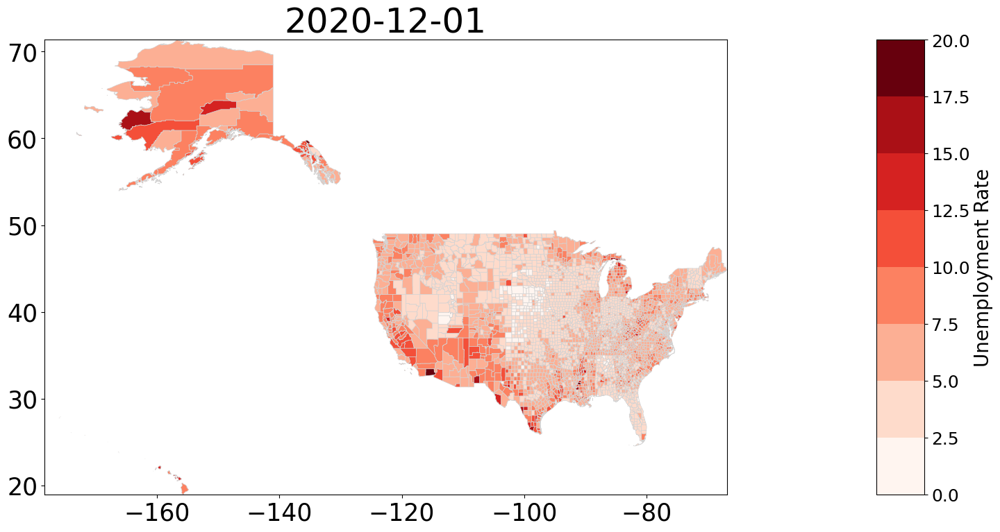

<class 'geopandas.geodataframe.GeoDataFrame'>


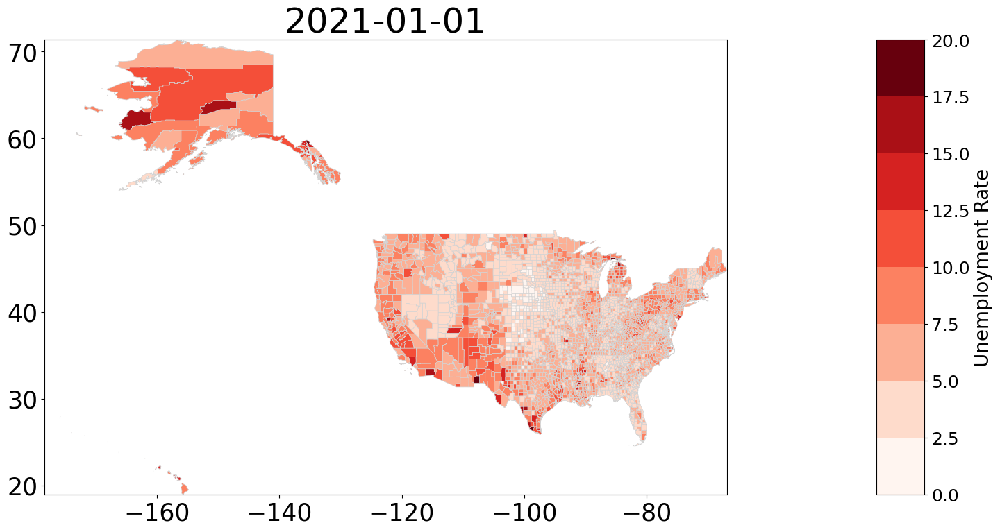

<class 'geopandas.geodataframe.GeoDataFrame'>


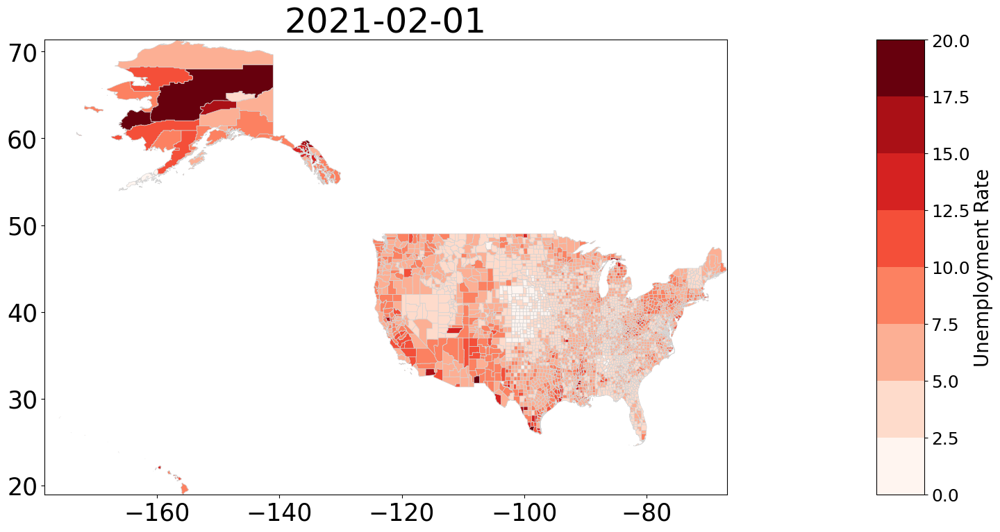

<class 'geopandas.geodataframe.GeoDataFrame'>


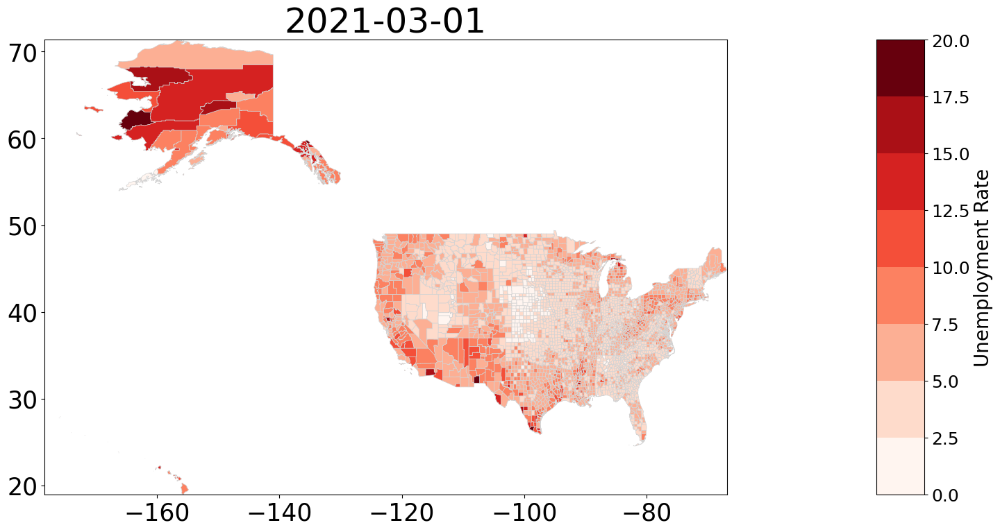

<class 'geopandas.geodataframe.GeoDataFrame'>


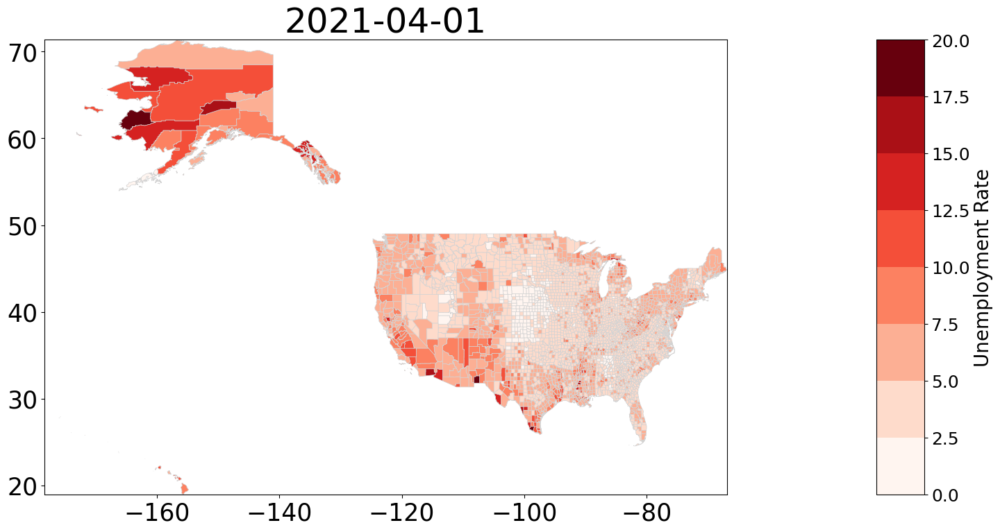

<class 'geopandas.geodataframe.GeoDataFrame'>


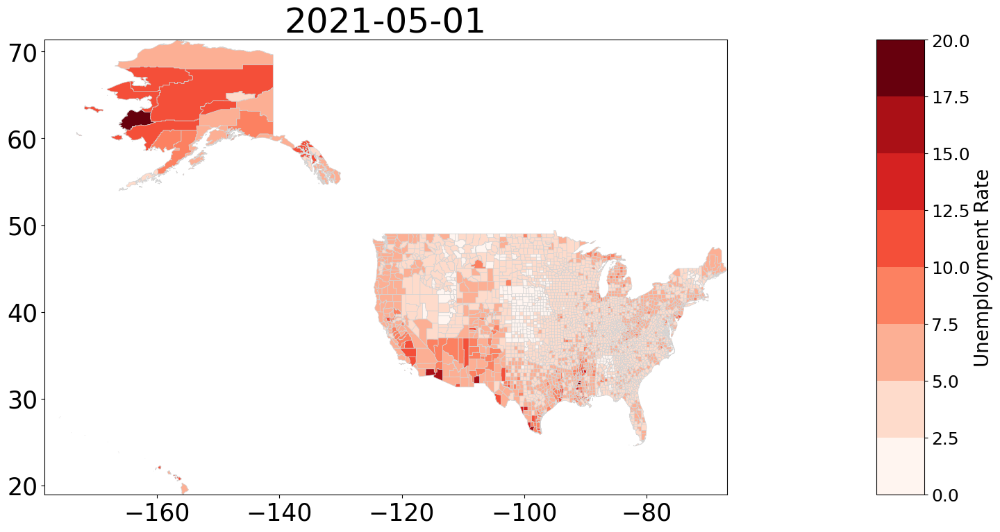

<class 'geopandas.geodataframe.GeoDataFrame'>


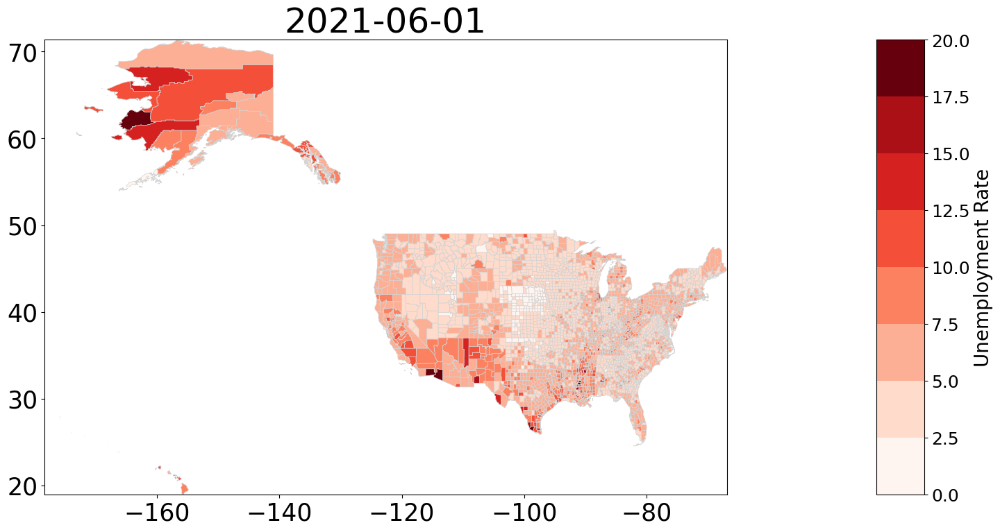

In [12]:
key = "Unemployment Rate"
df = u_data[key]#.dropna(axis=0)
pp = PdfPages("County Unemployment Rate.pdf")
for date in dates:
    fig, ax = plt.subplots(figsize=(19,9),
                          subplot_kw = {"aspect":"equal"})
    plt.rcParams.update({"font.size": 30})

    plt.xticks(fontsize = 25)
    plt.yticks(fontsize = 25)

    vmin = 0
    #vmax = u_data[key].fillna(0).max()
    vmax = 20
    cmap = cm.get_cmap("Reds", 8)
    norm = cm.colors.Normalize(vmin=vmin, vmax=vmax)
    ### add colorbar
    sm = cm.ScalarMappable(cmap=cmap, norm=norm)
    # prepare space for colorbar
    divider = make_axes_locatable(ax)
    size = "5%"
    cax = divider.append_axes("right", size = size, pad = .1)
    # add colorbar to figure
    cbar = fig.colorbar(sm, cax=cax, cmap= cmap)
    cbar.ax.tick_params(labelsize=18)
    vals = list(cbar.ax.get_yticks())
    vals.append(vmax)
    cbar.ax.set_yticklabels(vals)#[int(x) for x in vals])
    cbar.ax.set_ylabel(key, fontsize=20)

    # select data only from date
    print(type(df))
    df.plot(ax=ax, cax=ax, column = date,
            vmin=vmin, vmax=vmax,
            cmap=cmap, legend=False, 
            linewidth = .5, edgecolor="lightgrey",norm=norm)
    ax.set_title(str(date)[:10])
    plt.show()
#     pp.savefig(fig, bbox_inches = "tight")
    plt.close()
    
# close your pdf
pp.close()

In [13]:
# matplotlib will give us warning because we are setting the value a slice
import warnings
warnings.filterwarnings("ignore")
# Normalize Unemployment Feb-20 == 1
key = "Unemployment Rate"
new_key = "Normalized " + key + " (Feb 2020)"
# df.copy() makes a copy of the dataframe
u_data[new_key] = u_data[key]
# take the difference between the observed rate and the Feb rate
for date in dates:
    u_data[new_key][date] = u_data[key][date].sub(
        u_data[key][datetime.datetime(2020,2,1)])

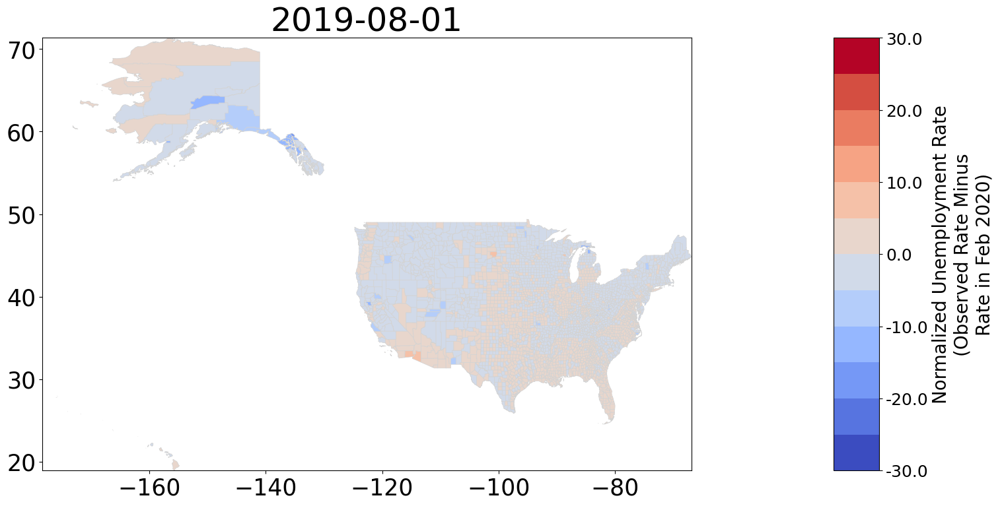

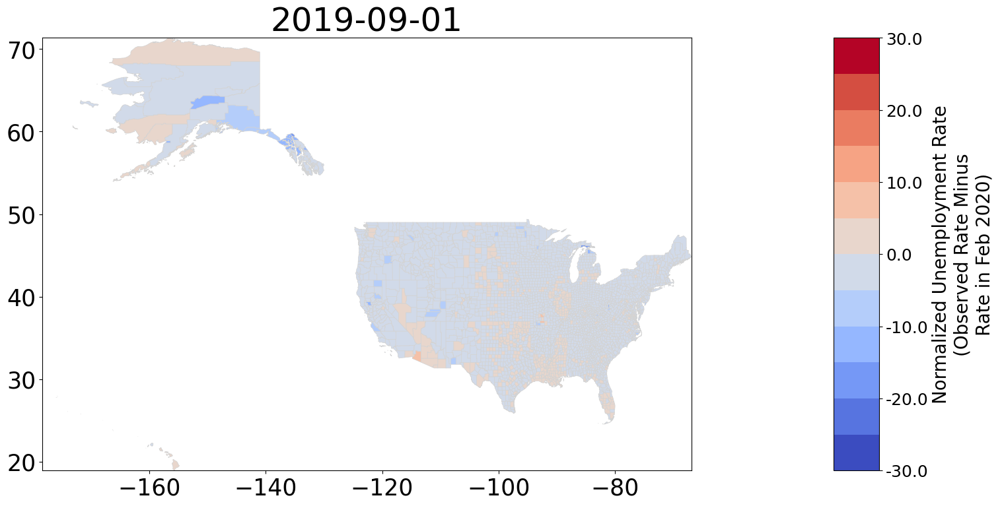

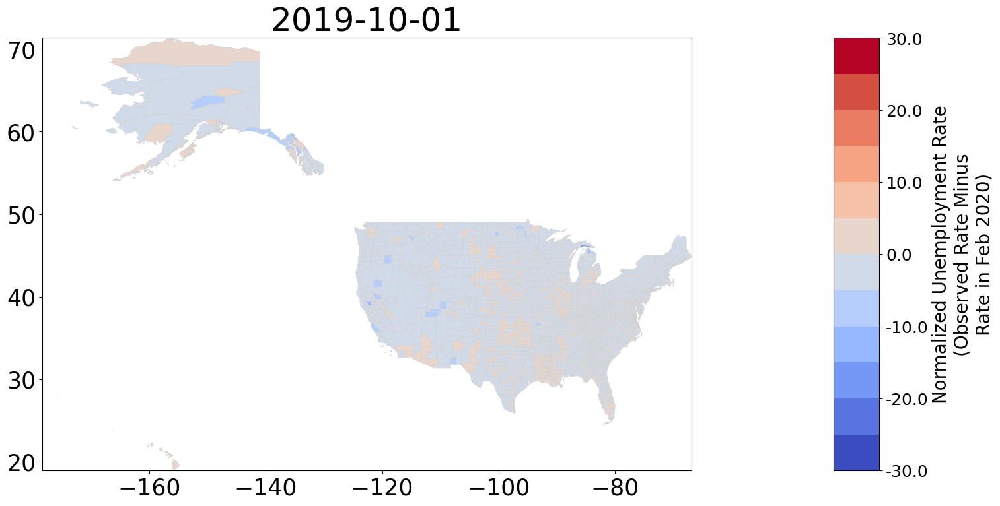

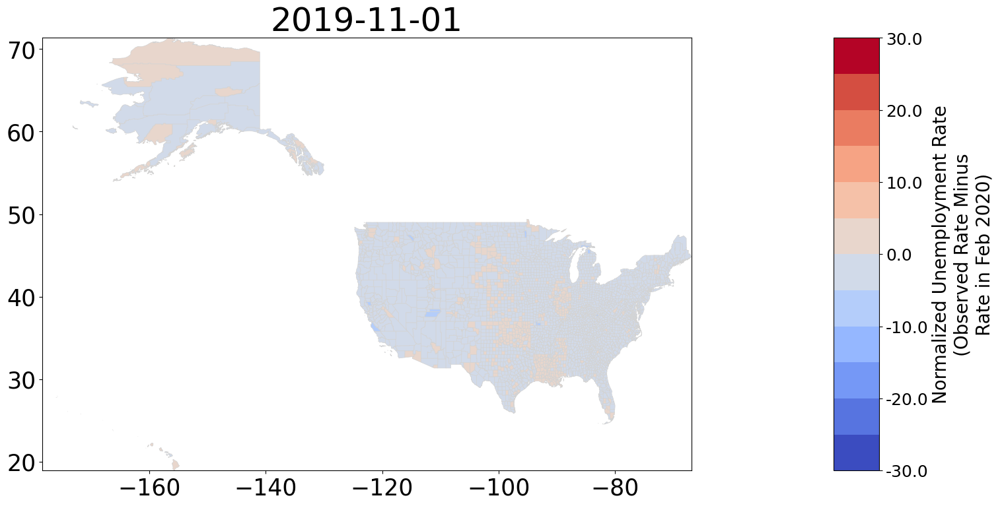

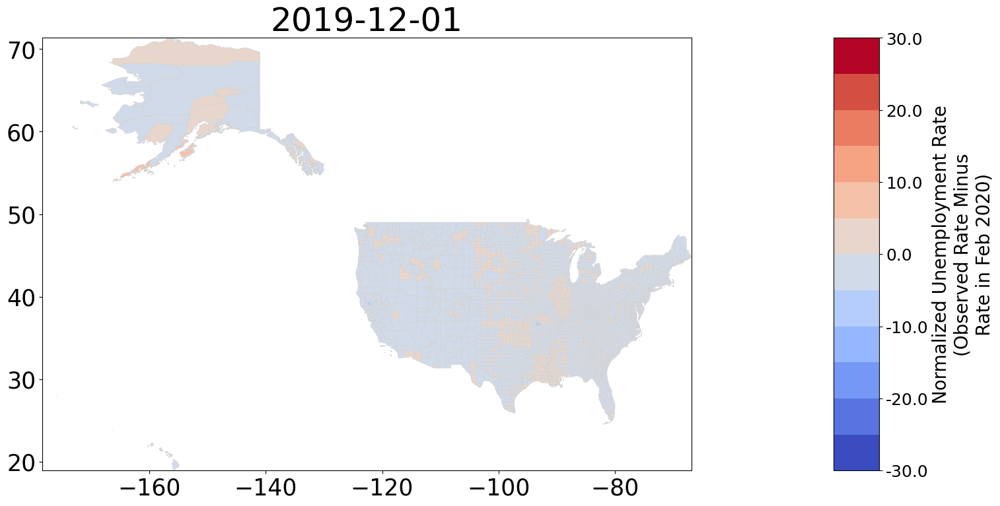

...

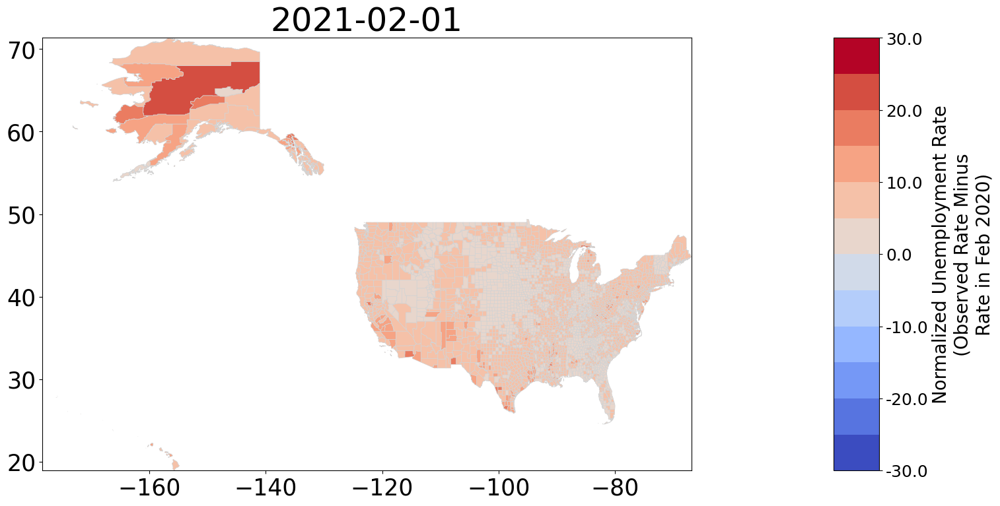

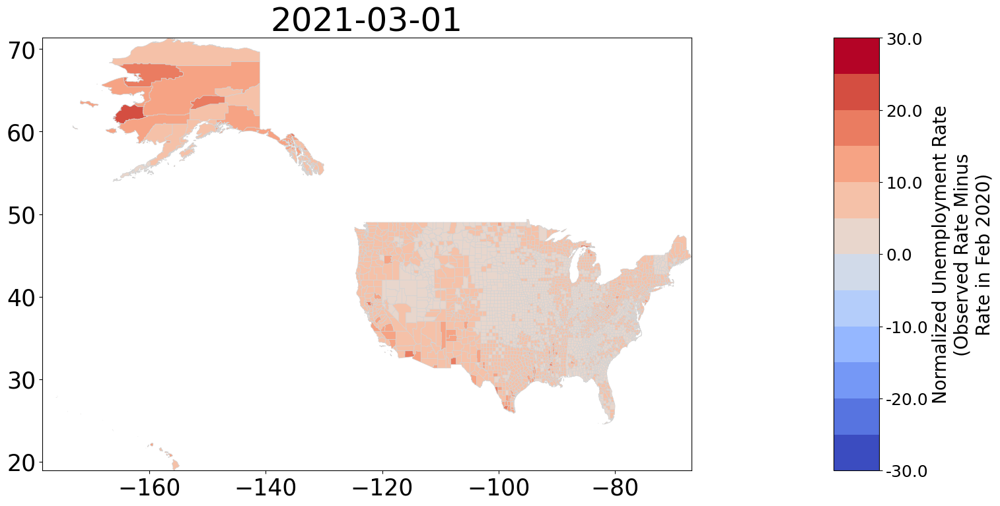

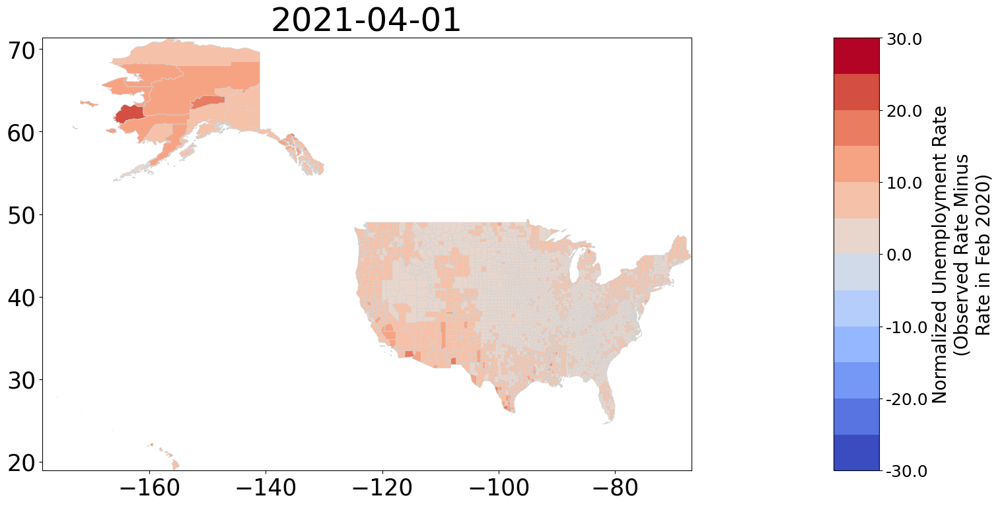

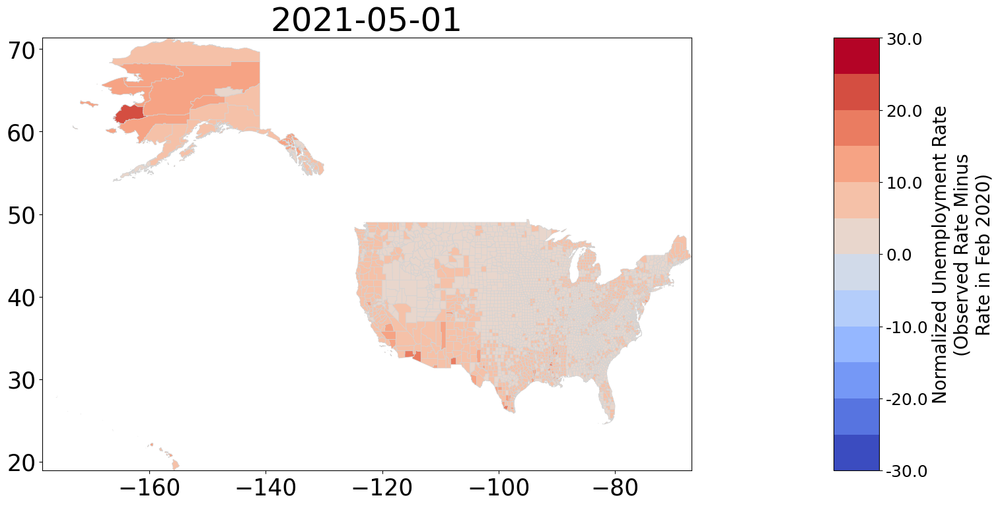

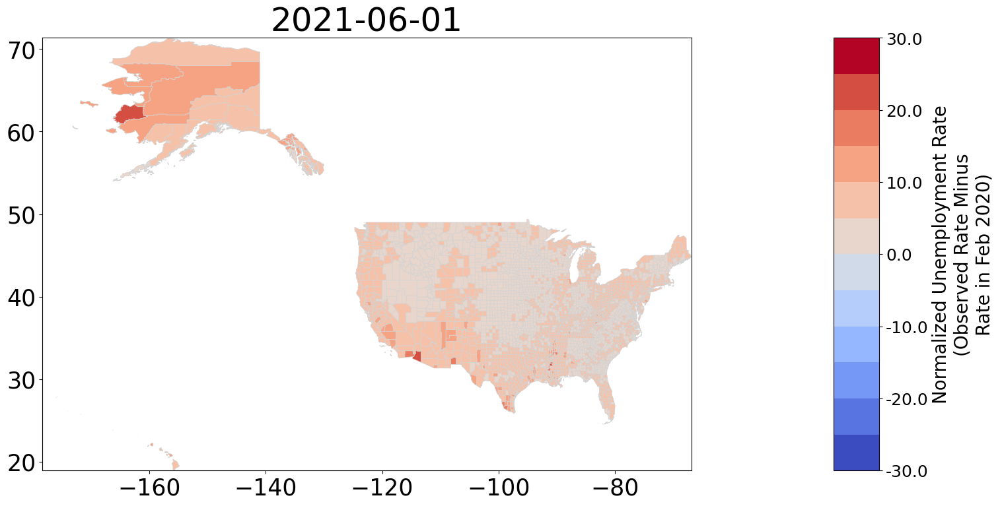

In [14]:
# pp = PdfPages("Normalized County Unemployment Rate.pdf")
df = u_data[new_key]#.dropna(axis=0)

for date in dates:
    # accomplishes same outcome as date.replace("-", " 20")
    title_date = str(date)[:10]
    fig, ax = plt.subplots(figsize=(19,9),
                          subplot_kw = {"aspect":"equal"})
    plt.rcParams.update({"font.size": 30})

    plt.xticks(fontsize = 25)
    plt.yticks(fontsize = 25)
    
    # set range color bar values
    vmin = -30# n_u_data["Unemployment Rate"].min()
    vmax = 30
    cmap = cm.get_cmap("coolwarm", 12)
    norm = cm.colors.Normalize(vmin=vmin, vmax=vmax)
    ### add colorbar
    sm = cm.ScalarMappable(cmap=cmap, norm=norm)
    # prepare space for colorbar
    divider = make_axes_locatable(ax)
    size = "5%"
    cax = divider.append_axes("right", size = size, pad = .1)
    # add colorbar to figure
    cbar = fig.colorbar(sm, cax=cax, cmap= cmap)
    cbar.ax.tick_params(labelsize=18)
    vals = list(cbar.ax.get_yticks())
    vals.append(vmax)
    cbar.ax.set_yticklabels(vals)
    cbar.ax.set_ylabel("Normalized "+key + "\n(Observed Rate Minus\nRate in Feb 2020)", fontsize=20)
    
    df.plot(ax=ax, cax=ax, column = date,
            vmin=vmin, vmax=vmax,
            cmap=cmap, legend=False, 
            linewidth = .5, edgecolor="lightgrey",norm=norm)
    ax.set_title(title_date)
    plt.show()
#     pp.savefig(fig, bbox_inches = "tight")
    plt.close()
# pp.close()

We can see that unemployment rates tended to increase in regions hardest hit by COVID-19 early on. While the correlation is not perfect, the jump in unemployment in the northeast, including New Jersey, and in Michigan seem to follow this trend. Still, other factors matter. For example, the fall in oil prices seems to have impacted western Texas and western North Dakota. And although spread was limited on the West Coast, especially in California, a relatively strict lockdown there seems to be associated with higher levels of unemployment.

The interested student would benefit from running a panel regression ([see Chapter 8](https://github.com/jlcatonjr/Learn-Python-for-Stats-and-Econ/blob/master/Textbook/Chapter%208%20-%20Advanced%20Data%20Analysis.ipynb)) that includes factors like the stringency of lockdown and the severity of spread of COVID-19, along with other variables relevant to the level of unemployment, to estimate the effects of these elements on the overall level of unemployment.

In [15]:
import plotly.express as px
plot_df = u_data[new_key]
plot_df.rename(columns = {name:str(name) for name in plot_df.keys()}, inplace = True)
plot_df

'Normalized Unemployment Rate (Feb 2020)'

In [16]:
import plotly.express as px
plot_df = df.to_crs(epsg=4326).rename(columns = {date:str(date)[:10] for date in df[dates].keys()})

cname = str(dates[-1])[:10]
plot_df[cname] = plot_df[cname].round(2)
hover_name = "NAME"
fig = px.choropleth_mapbox(plot_df.reset_index(), 
                    geojson = plot_df,
#                            featureidkey = "fips_code",
                           locations = 'fips_code',
                           hover_name=hover_name,
                           hover_data = [cname],
                           color=cname, 
#                            animation_frame="Variable Name",
                           color_continuous_scale="ylgnbu",
                           center={'lat':df["geometry"].centroid.y.mean(), 
                                   'lon':df["geometry"].centroid.x.mean()},
                            zoom = 5,
                            opacity=.6,
#                            range_color=(plot_df[cname].min(), plot_df[cname].max()),
                           title= new_key ,
                           mapbox_style="carto-positron",
                           height=900,
#                            labels={cname:'U Change:' + cname  }
)


# fig.show()
fig.write_html(new_key+".html")

## Mapping Economic Freedom and Economic Performance 

### Add Economic Freedom Data
[World Map Reference](https://geopandas.org/en/stable/docs/user_guide/mapping.html)

### Under Construction, map country population and cities 

In [43]:
world = geopandas.read_file(geopandas.datasets.get_path(
    'naturalearth_lowres')).to_crs(epsg=4326)
cities = geopandas.read_file(geopandas.datasets.get_path(
    'naturalearth_cities')).to_crs(epsg=4326)
EFW = pd.read_csv("fraserDataWithRGDPPC.csv",
                  index_col = ["ISO_Code_3","Year"],
                  parse_dates = True).rename(columns = {"Summary":"EFW"})

EFW

ISO_Code_2   World Bank Region  \
ISO_Code_3 Year                                        
AGO        1970-01-01         AO  Sub-Saharan Africa   
           1975-01-01         AO  Sub-Saharan Africa   
           1980-01-01         AO  Sub-Saharan Africa   
           1985-01-01         AO  Sub-Saharan Africa   
           1990-01-01         AO  Sub-Saharan Africa   
...                          ...                 ...   
ZWE        2016-01-01         ZW  Sub-Saharan Africa   
           2017-01-01         ZW  Sub-Saharan Africa   
           2018-01-01         ZW  Sub-Saharan Africa   
           2019-01-01         ZW  Sub-Saharan Africa   
           2020-01-01         ZW  Sub-Saharan Africa   

                      World Bank Current Income Classification, 1990-present (L=Low income, LM=Lower middle income, UM=Upper middle income, H=High income)  \
ISO_Code_3 Year                                                                                                                                              
AGO        1970-01-01                                                NaN                                                                                     
           1975-01-01                                                NaN                                                                                     
           1980-01-01                                                NaN                                                                                     
           1985-01-01                                                NaN                                                                                     
           1990-01-01                                                 LM                                                                                     
...                                                                  ...                                                                                     
ZWE        2016-01-01                                                  L                                                                                     
           2017-01-01                                                  L                                                                                     
           2018-01-01                                                 LM                                                                                     
           2019-01-01                                                 LM                                                                                     
           2020-01-01                                                 LM                                                                                     

                      Countries       EFW  Size of Government  \
ISO_Code_3 Year                                                 
AGO        1970-01-01    Angola       NaN                 NaN   
           1975-01-01    Angola       NaN                 NaN   
           1980-01-01    Angola       NaN                 NaN   
           1985-01-01    Angola       NaN                 NaN   
           1990-01-01    Angola       NaN                 NaN   
...                         ...       ...                 ...   
ZWE        2016-01-01  Zimbabwe  6.121996            5.332597   
           2017-01-01  Zimbabwe  5.599886            4.699843   
           2018-01-01  Zimbabwe  5.876298            5.170946   
           2019-01-01  Zimbabwe  4.719465            5.628359   
           2020-01-01  Zimbabwe  4.480000            5.562008   

                       Legal System and Property Rights  Sound Money  \
ISO_Code_3 Year                                                        
AGO        1970-01-01                               NaN          NaN   
           1975-01-01                               NaN          NaN   
           1980-01-01                               NaN          NaN   
           1985-01-01           

In [44]:
world.set_index("iso_a3", inplace = True)

In [45]:
for key in ["RGDP Per Capita", "EFW"]:
    for year in ("2018", "2020"):
        world[key + " " + year] = EFW[
            EFW.index.get_level_values("Year") == year].reset_index().set_index("ISO_Code_3")[key]
        world[key + " " + year + " Rank"] = EFW[
            EFW.index.get_level_values("Year") == year].reset_index().set_index("ISO_Code_3")[key].rank(ascending = False)
        
world

,pop_est,continent,name,gdp_md_est,geometry,RGDP Per Capita 2018,RGDP Per Capita 2018 Rank,RGDP Per Capita 2020,RGDP Per Capita 2020 Rank,EFW 2018,EFW 2018 Rank,EFW 2020,EFW 2020 Rank
iso_a3,,,,,,,,,,,,,
FJI,889953.0,Oceania,Fiji,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",NaN,NaN,NaN,NaN,6.180535,121.0,6.53,104.0
TZA,58005463.0,Africa,Tanzania,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",2874.9629,128.0,NaN,NaN,6.649848,101.0,6.55,100.5
ESH,603253.0,Africa,W. Sahara,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CAN,37589262.0,North America,Canada,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",44868.7435,17.0,NaN,NaN,8.109616,13.0,7.81,14.0
USA,328239523.0,North America,United States of America,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",55334.7394,9.0,NaN,NaN,8.279612,6.0,7.97,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRB,6944975.0,Europe,Serbia,51475,"POLYGON ((18.82982 45.90887, 18.82984 45.90888...",14124.1177,71.0,NaN,NaN,7.129546,77.0,6.82,84.0
MNE,622137.0,Europe,Montenegro,5542,"POLYGON ((20.07070 42.58863, 19.80161 42.50009...",19504.1588,56.0,NaN,NaN,7.450013,56.0,7.46,40.0
-99,1794248.0,Europe,Kosovo,7926,"POLYGON ((20.59025 41.85541, 20.52295 42.21787...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [46]:
cities["Country"] = ""
for ix in cities.index:
    try:
        # save the name of the country if the city falls within its boundaries
        cities.loc[ix, "Country"] = world[
            world["geometry"].contains(
                cities.loc[ix]["geometry"])].index[0]
    except:
        continue
cities[cities["Country"] != ""]

,name,geometry,Country
0,Vatican City,POINT (12.45339 41.90328),ITA
1,San Marino,POINT (12.44177 43.93610),ITA
2,Vaduz,POINT (9.51667 47.13372),AUT
3,Lobamba,POINT (31.20000 -26.46667),SWZ
4,Luxembourg,POINT (6.13000 49.61166),LUX
...,...,...,...
238,Rio de Janeiro,POINT (-43.21212 -22.90731),BRA
239,São Paulo,POINT (-46.62697 -23.55673),BRA
240,Sydney,POINT (151.21255 -33.87137),AUS
241,Singapore,POINT (103.85387 1.29498),MYS


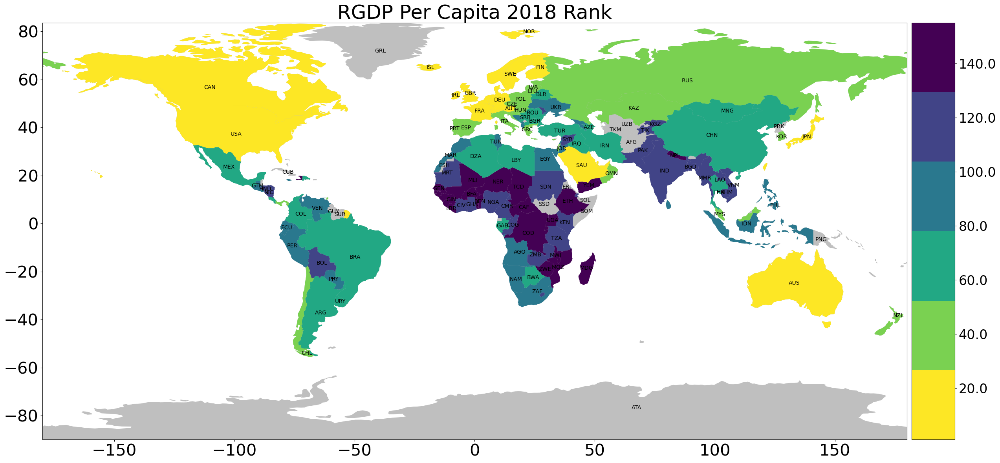

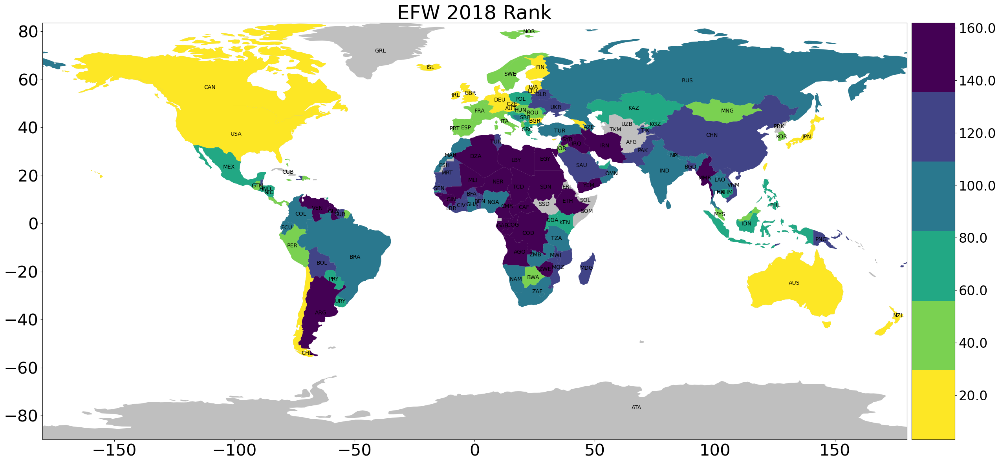

In [47]:
for column in ["RGDP Per Capita 2018 Rank", "EFW 2018 Rank"]:
    fig, ax = plt.subplots(figsize = (30,20))
    cmap = cm.get_cmap("viridis_r", 6)
#     norm = cm.colors.LogNorm(vmin = world[column].min(), 
#                                vmax = world[column].max())
    norm = cm.colors.Normalize(vmin = world[column].min(), 
                               vmax = world[column].max())
    ### add colorbar
    sm = cm.ScalarMappable(cmap=cmap, norm=norm)
    # prepare space for colorbar
    divider = make_axes_locatable(ax)
    size = "5%"
    cax = divider.append_axes("right", size = size, pad = .1)
    # add colorbar to figure
    cbar = fig.colorbar(sm, cax=cax, cmap= cmap)
    cbar.ax.tick_params(labelsize=24)
    vals = list(cbar.ax.get_yticks())
    vals.append(vmax)
    cbar.ax.set_yticklabels(vals)
    world.plot(color = "k", alpha = .25, ax = ax)
    world.plot(column = column, cmap = cmap, norm = norm, ax = ax)
#     cities[cities["Country"]!=""].plot(color = "C3", 
#                                        markersize = 50, 
#                                        ax = ax)
    ax.set_title(column)
    area = world.area
    for ix in world.index:
        if area[ix] >= area["IRL"]:
            centroid = world.loc[ix]["geometry"].representative_point()
            x,y = centroid.x, centroid.y 
            ax.text(x, y, ix, va = "center", ha = "center", fontsize = 10)


In [49]:
oecd_countries = ["Australia", "Austria", "Belgium", "Canada", "Chile", "Colombia", "Costa Rica",
            "Czech Republic", "Denmark", "Estonia", "Finland", "France", "Germany",
            "Greece", "Hungary", "Iceland", "Ireland", "Israel", "Italy", "Japan", 
            "Latvia", "Lithuania","Luxembourg", "Mexico", "Netherlands", "New Zealand", "Norway",
             "Poland","Portugal", 'Slovak Republic', "Slovenia", 'Korea, Rep.', "Spain", "Sweden",
             "Switzerland", "Turkey", "United Kingdom", "United States"]
efw_measures = ["EFW", "Legal System and Property Rights", "Freedom to Trade Internationally", "Size of Government", "Sound Money", "Regulation"]
plot_df = EFW.reset_index().set_index("Countries").loc[oecd_countries].reset_index()
plot_keys = ["RGDP Per Capita","Year","ISO_Code_3"]+ efw_measures
plot_df = plot_df[plot_keys]
years = [str(i) for i in range(1975, 2021,5)]
plot_df = plot_df.set_index(["Year","ISO_Code_3"]).loc[years]
plot_df

RGDP Per Capita       EFW  \
Year       ISO_Code_3                              
1975-01-01 AUS                 20993.0  7.002204   
           AUT                 18564.0  6.536509   
           BEL                 19831.0  6.801845   
           CAN                 22819.0  7.700629   
           CHL                  6731.0  4.002002   
...                                ...       ...   
2020-01-01 SWE                     NaN  7.560000   
           CHE                     NaN  8.370000   
           TUR                     NaN  6.480000   
           GBR                     NaN  7.710000   
           USA                     NaN  7.970000   

                       Legal System and Property Rights  \
Year       ISO_Code_3                                     
1975-01-01 AUS                                 8.034445   
           AUT                                 6.713631   
           BEL                                 5.407128   
           CAN                                 8.395791   
           CHL                                 3.844095   
...                                                 ...   
2020-01-01 SWE                                 7.927697   
           CHE                                 8.735912   
           TUR                                 4.837391   
           GBR                                 7.748649   
           USA                                 7.555009   

                       Freedom to Trade Internationally  Size of Government  \
Year       ISO_Code_3                                                         
1975-01-01 AUS                                 5.692162            6.255684   
           AUT                                 7.013307            4.771273   
           BEL                                 8.931724            5.192224   
           CAN                                 8.255897            5.871790   
           CHL                                 4.403152            6.800078   
...                                                 ...                 ...   
2020-01-01 SWE                                 8.134869            4.434866   
           CHE                                 7.631771            7.522199   
           TUR                                 6.922064            6.518394   
           GBR                                 7.717691            5.926207   
           USA                                 7.765508            6.790621   

                       Sound Money  Regulation  
Year       ISO_Code_3                           
1975-01-01 AUS            8.346907    6.761980  
           AUT            8.038093    6.143161  
           BEL            9.013972    5.439502  
           CAN            8.602702    7.435906  
           CHL            0.009989    5.461314  
...                            ...         ...  
2020-01-01 SWE            9.620914    7.668919  
           CHE            9.857416    8.096077  
           TUR            8.267587    5.876017  
           GBR            9.602894    7.575806  
           USA            9.626843    8.109914  

[380 rows x 7 columns]

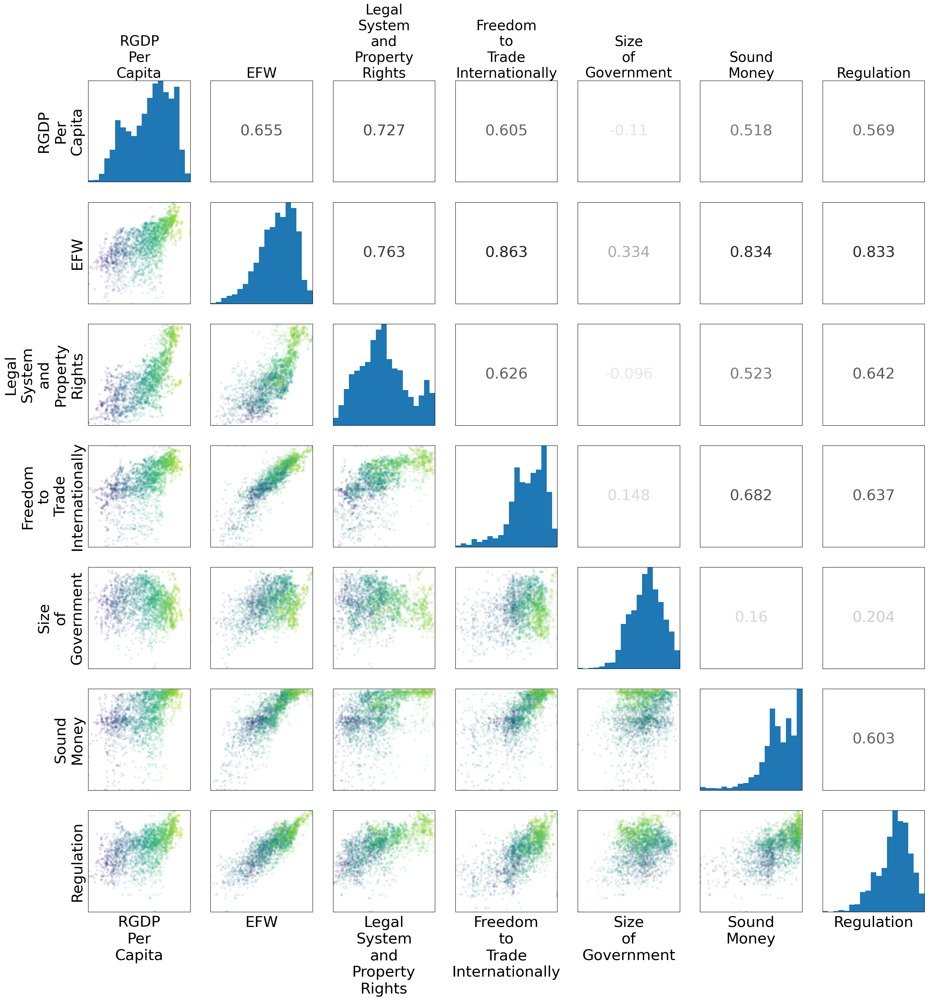

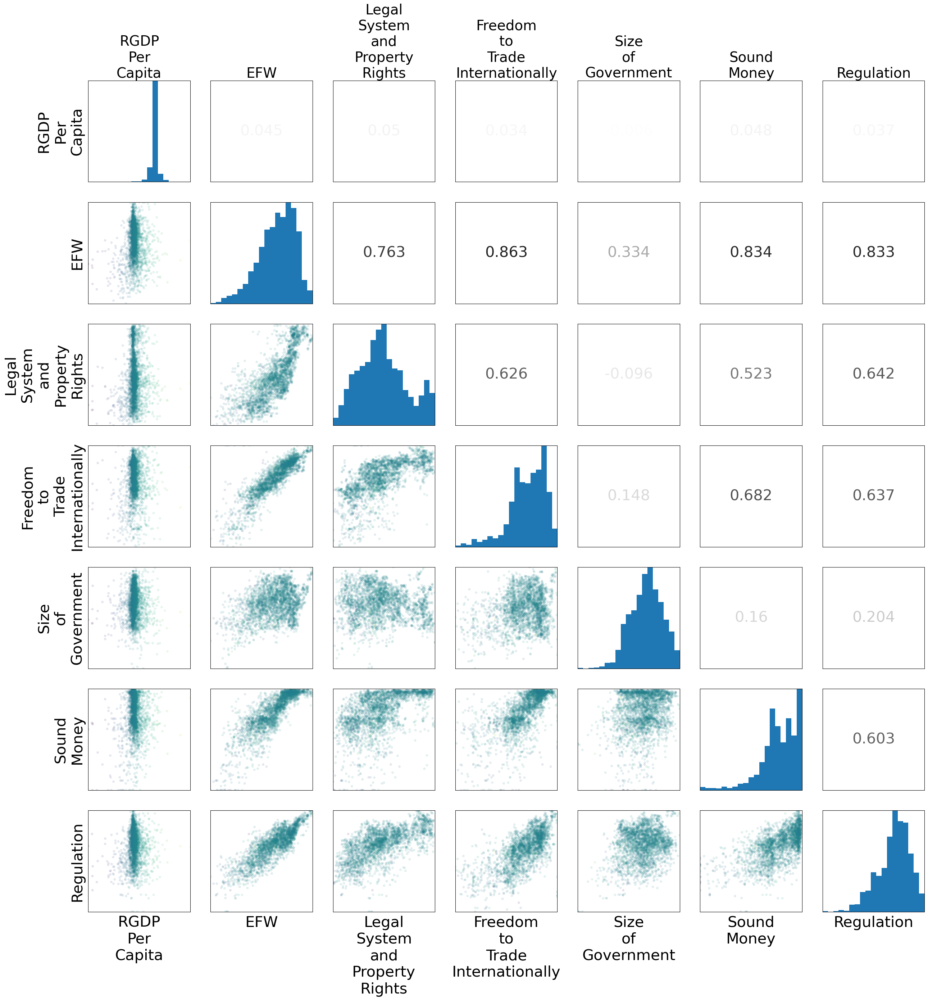

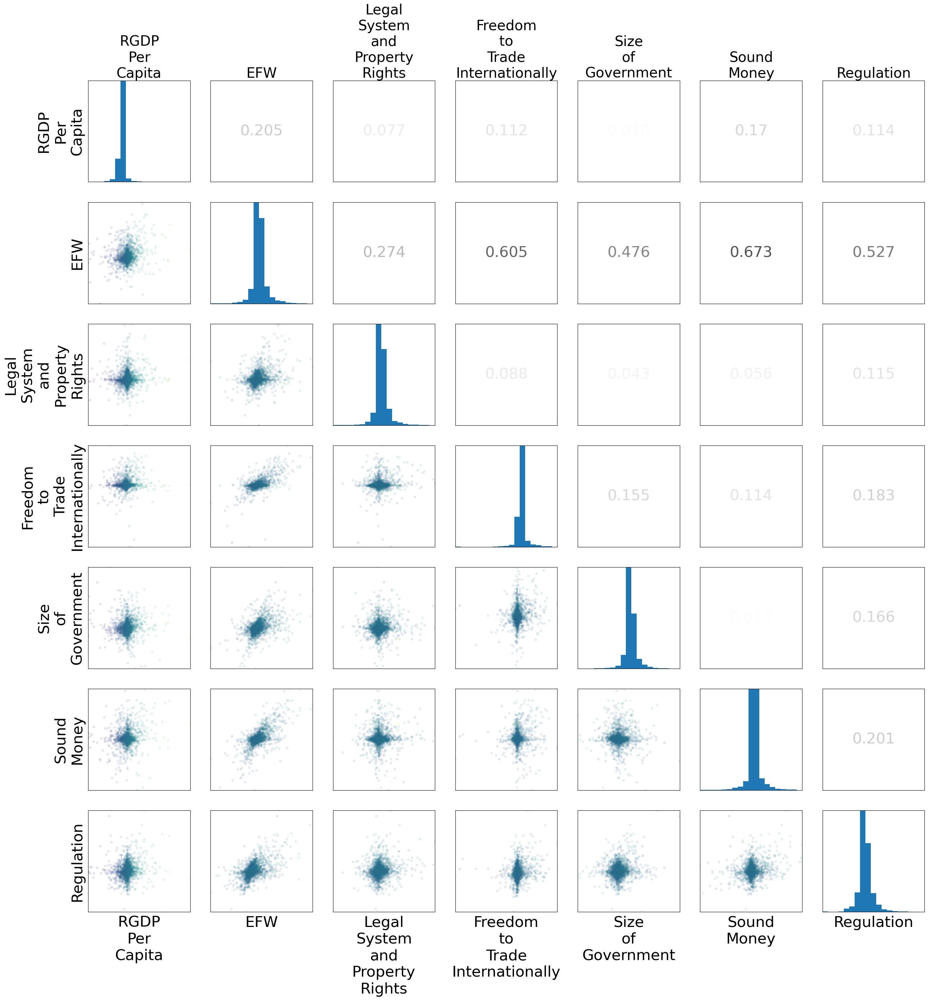

In [112]:
def df_corr_plots(df, s = 15,alpha = .1, title = "", log_color = False):
    plot_keys = list(df.keys())
    k = len(plot_keys)
    color = df["RGDP Per Capita"]
    if log_color:
        color = np.log(color)
    fig, axs = plt.subplots(k,k, figsize = (30,30))
    color = df["RGDP Per Capita"]
    for i in range(k):
        for j in range(k):
            ax = axs[i][j]
            xlabel = plot_keys[j]
            ylabel = plot_keys[i]
            xmin = df[xlabel].min()
            xmax = df[xlabel].max()
            ymin = df[ylabel].min()
            ymax = df[ylabel].max()

            if i > j:
                df.plot.scatter(x = xlabel, y = ylabel, c = color,
                                     s = s, alpha = alpha, cmap = "viridis", ax = ax, colorbar = False, legend = False)
            elif i == j :
                nbins = 20
                bin_length = (xmax - xmin) / nbins
                df.plot.hist(column = plot_keys[j], ax = ax, legend = False, bins = [xmin + i * bin_length  for i in range(0,nbins)])
            elif i < j:
                xloc = (xmin + xmax) / 2
                yloc = (ymin + ymax) / 2
                corr_val = df[[xlabel, ylabel]].corr().round(3).iloc[0][1]
                ax.text(.5, .5, str(corr_val), 
                        ha = "center", va = "center", alpha =abs(corr_val))
            if i == 0:
                ax.set_title(xlabel.replace(" ","\n"),fontsize = 28)
            if i + 1 != k:
                ax.set_xlabel("")
            if i + 1 == k:
                ax.set_xlabel(xlabel.replace(" ","\n"))

            if j != 0:
                ax.set_ylabel("")
            else:
                ax.set_ylabel(ylabel.replace(" ","\n"))
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_xticks([]) 
            ax.set_yticks([]) 
            fig.suptitle(title)
gdp_log_df = plot_df.copy()
gdp_log_df["RGDP Per Capita"] = np.log(plot_df["RGDP Per Capita"])
df_corr_plots(gdp_log_df, log_color = False)
gdp_diff_df = gdp_log_df.copy()
gdp_diff_df["RGDP Per Capita"] = gdp_log_df["RGDP Per Capita"].groupby("ISO_Code_3").diff()
df_corr_plots(gdp_diff_df)
df_corr_plots(gdp_diff_df.groupby("ISO_Code_3").diff())



Text(0.02, 0.5, '$\\Delta$ 1975-2018')

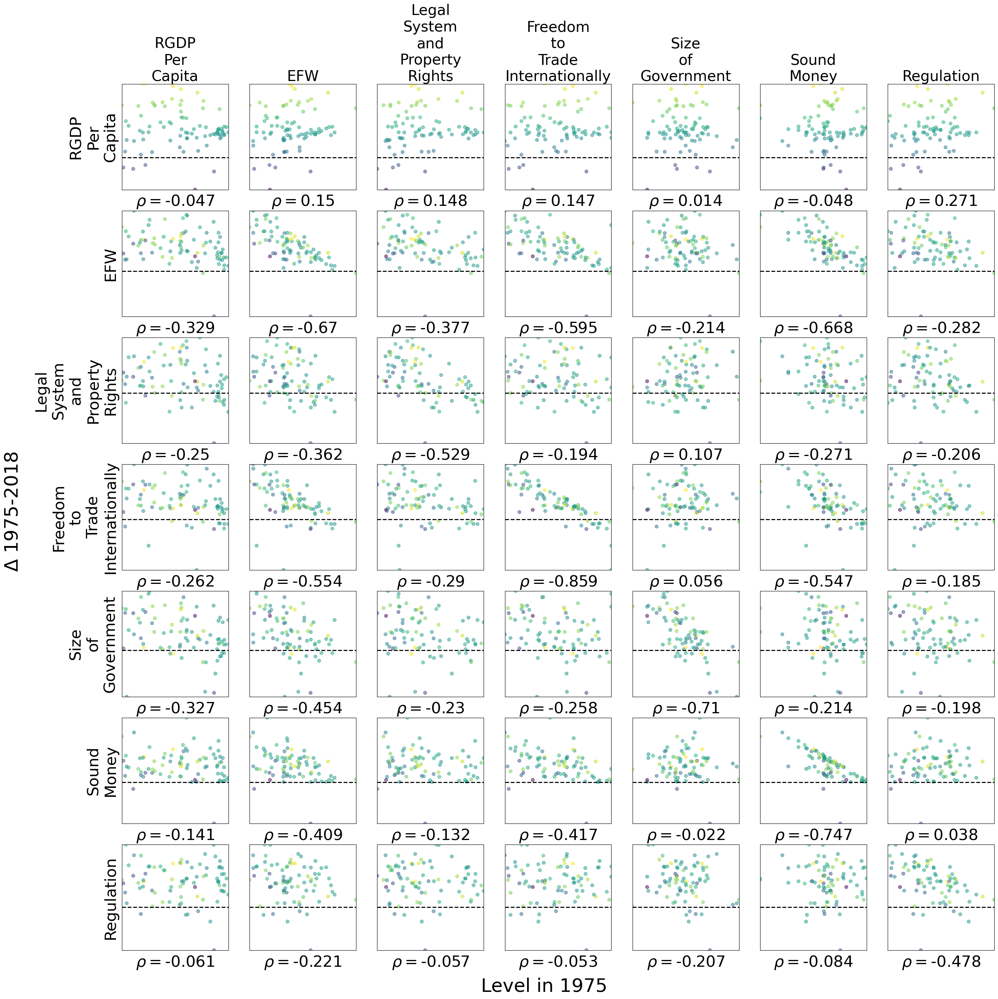

In [123]:
plot_df = EFW[["RGDP Per Capita"] + efw_measures].reset_index()
plot_df = plot_df.set_index(["Year","ISO_Code_3"])
plot_df["RGDP Per Capita"] = np.log(plot_df["RGDP Per Capita"])

log_df = plot_df.copy()
start_year = "1975"
end_year = "2018"
df_1975 = log_df.loc[start_year].groupby("ISO_Code_3").mean().dropna()
change_df = log_df.loc[end_year].groupby("ISO_Code_3").mean().sub(log_df.loc["1975"].groupby("ISO_Code_3").mean()).dropna()
# fig, ax = plt.subplots(figsize = (12,12))
# ax.plot(df_1975["RGDP Per Capita"], change_df["RGDP Per Capita"], marker = ".", ls = "")
plot_keys = list(log_df.keys())
k = len(plot_keys)
color = change_df["RGDP Per Capita"]
# if log_color:
#     color = np.log(color)
fig, axs = plt.subplots(k,k, figsize = (30,30))
for i in range(k):
    for j in range(k):
        ax = axs[i][j]
        xlabel = plot_keys[j]
        ylabel = plot_keys[i]
#         ax.text(.5, .5, str(np.cor(df_1975[xlabel], change_df[ylabel])), 
#                         ha = "center", va = "center", alpha =abs(corr_val))

        scatter_df = pd.DataFrame([df_1975[xlabel], change_df[ylabel]],
                                   index = [xlabel + " " + start_year, ylabel + " Diff"]).T
        xlabel = xlabel + " " + start_year
        ylabel = ylabel + " Diff"
        scatter_df.plot.scatter(x = xlabel, y = ylabel,
                                alpha = .5,
                                s = 40,
                                cmap = "viridis",
                                c = color,colorbar = False, legend = False,
               ax = ax)
        if i == 0:
            ax.set_title(xlabel.replace(" " + start_year, "").replace(" ","\n"),fontsize = 28)
        if i + 1 != k:
            ax.set_xlabel("")
        if i + 1 == k:
            ax.set_xlabel(xlabel.replace(" " + start_year, "").replace(" ","\n"))

        if j != 0:
            ax.set_ylabel("")
        else:
            ax.set_ylabel(ylabel.replace(" Diff","").replace(" ","\n"))
        ax.axhline(0, color = "k", ls = "--", linewidth = 2)
        
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_xticks([]) 
        ax.set_yticks([]) 
        ax.set_xlabel("$\\rho=$"+scatter_df[[xlabel, ylabel]].corr().round(3).astype(str).loc[xlabel][ylabel])

fig.supxlabel("Level in " + start_year, y = 0.07)
fig.supylabel("$\\Delta$ " + start_year + "-" + end_year)

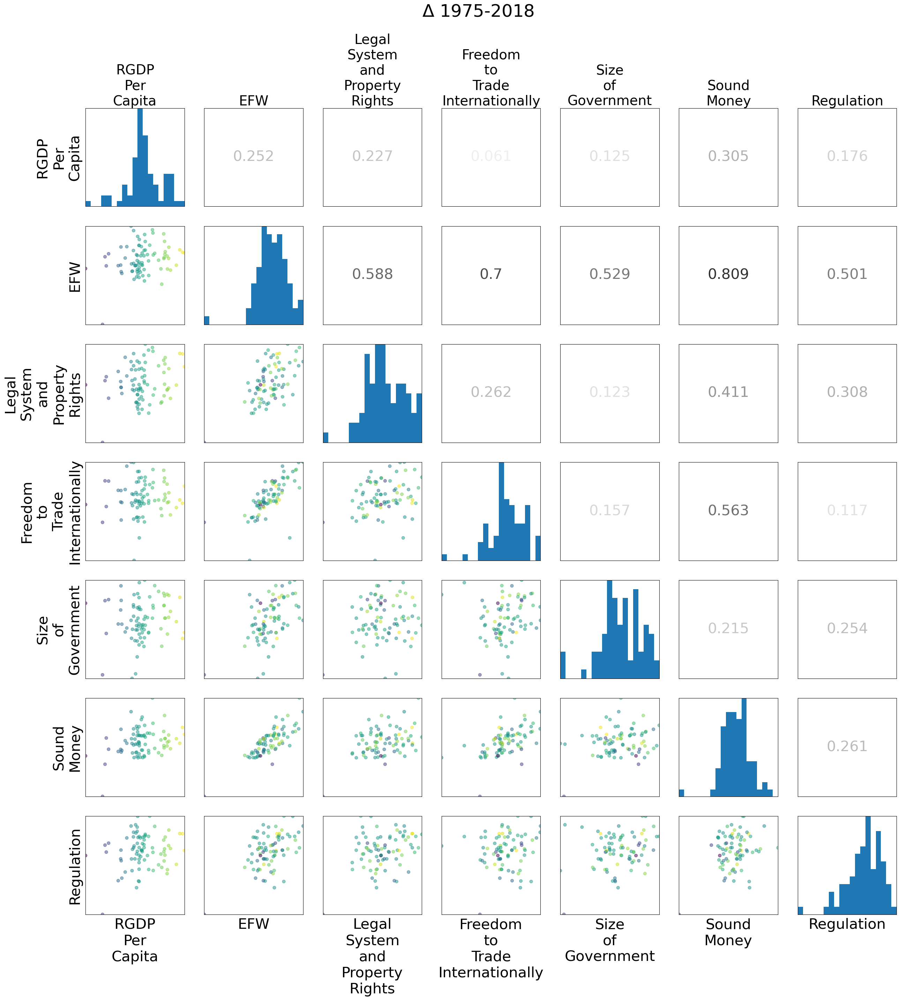

In [124]:
df_corr_plots(change_df, s= 40, alpha = .5, title = "$\\Delta$ " + start_year + "-" + end_year)

In [115]:
change_df.sub(change_df.mean())

,RGDP Per Capita,EFW,Legal System and Property Rights,Freedom to Trade Internationally,Size of Government,Sound Money,Regulation
ISO_Code_3,,,,,,,
ARG,-0.519000,0.944233,0.371258,4.544168,-0.596168,-0.254262,0.807812
AUS,-0.014583,-0.450643,-0.527449,-0.156644,-0.533097,-1.371495,0.447461
AUT,-0.039328,-0.415033,0.815587,-0.946058,-0.389985,-1.350706,0.028846
BDI,-1.183291,-0.498486,0.325524,-1.396300,-0.994987,0.597206,-0.089829
BEL,-0.183507,-0.920312,1.243317,-2.945264,-1.549176,-2.351774,1.228670
...,...,...,...,...,...,...,...
URY,-0.021496,0.462485,0.294695,-0.686658,-0.940178,3.982564,-0.059176
USA,-0.122029,-1.365840,-1.817103,-3.034172,0.950176,-1.962971,-0.754501
VEN,-1.304220,-4.896897,-3.524918,-3.721035,-4.037096,-8.843049,-4.041331


### Homework

1. Find a way to represent the entire time series in a single file. You may either save a visualization for every data on separate pages in a pdf or you may create an MP4 or GIF file. Make sure that for every frame, the correct date is indicated. See how to accomplish this [here](https://github.com/jlcatonjr/Learn-Python-for-Stats-and-Econ/blob/master/Projects/COVID19/Visualizing%20COVID-19%20Data%20at%20the%20State%20and%20County%20Levels%20in%20Python%20-%20Part%20III.ipynb). Differentiate your answer from the template provided in at least 3 ways. Identify *how* your output is differentiated.

2. Select a different time series data (e.g., incomes, etc...) set at the county level that has at least 20 observations. Create a map of the latest obervation of the data. Like with the covid data in (1), create a file that holds a visualization for every observation.
